# Assignment Module 2: Product Classification

Students:
- 0001132284 - Luca Babboni     -  Luca.babboni2@studio.unibo.it
- 0001116370 - Paul Ioan Clotan - paulioan.clotan@studio.unibo.it
- 0001131730 - Norberto Casarin - norberto.casarin@studio.unibo.it


The goal of this assignment is to implement a neural network that classifies smartphone pictures of products found in grocery stores. The assignment will be divided into two parts: first, you will be asked to implement from scratch your own neural network for image classification; then, you will fine-tune a pretrained network provided by PyTorch.


## Preliminaries: the dataset

The dataset you will be using contains natural images of products taken with a smartphone camera in different grocery stores:

<p align="center">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Granny-Smith.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Pink-Lady.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Lemon.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Banana.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Vine-Tomato.jpg" width="150">
</p>
<p align="center">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Yellow-Onion.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Green-Bell-Pepper.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Arla-Standard-Milk.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Oatly-Natural-Oatghurt.jpg" width="150">
  <img src="https://github.com/marcusklasson/GroceryStoreDataset/raw/master/sample_images/natural/Alpro-Fresh-Soy-Milk.jpg" width="150">
</p>

The products belong to the following 43 classes:
```
0.  Apple
1.  Avocado
2.  Banana
3.  Kiwi
4.  Lemon
5.  Lime
6.  Mango
7.  Melon
8.  Nectarine
9.  Orange
10. Papaya
11. Passion-Fruit
12. Peach
13. Pear
14. Pineapple
15. Plum
16. Pomegranate
17. Red-Grapefruit
18. Satsumas
19. Juice
20. Milk
21. Oatghurt
22. Oat-Milk
23. Sour-Cream
24. Sour-Milk
25. Soyghurt
26. Soy-Milk
27. Yoghurt
28. Asparagus
29. Aubergine
30. Cabbage
31. Carrots
32. Cucumber
33. Garlic
34. Ginger
35. Leek
36. Mushroom
37. Onion
38. Pepper
39. Potato
40. Red-Beet
41. Tomato
42. Zucchini
```

The dataset is split into training (`train`), validation (`val`), and test (`test`) set.

The following code cells download the dataset and define a `torch.utils.data.Dataset` class to access it. This `Dataset` class will be the starting point of your assignment: use it in your own code and build everything else around it.

In [1]:
!git clone https://github.com/marcusklasson/GroceryStoreDataset.git

Cloning into 'GroceryStoreDataset'...
remote: Enumerating objects: 6559, done.
remote: Counting objects: 100% (266/266), done.
remote: Compressing objects: 100% (231/231), done.
remote: Total 6559 (delta 45), reused 35 (delta 35), pack-reused 6293 (from 1)
Receiving objects: 100% (6559/6559), 116.26 MiB | 24.12 MiB/s, done.
Resolving deltas: 100% (275/275), done.


In [2]:
import os
import csv
import random
import numpy as np
import pandas as pd
from os.path import join

from typing import List, Tuple
from collections import Counter

from PIL import Image
from pathlib import Path
from typing import List, Tuple
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.notebook import tqdm

import torch
import torch.nn as nn
from torch import Tensor
import torch.nn.functional as F
from torch.utils.data import Dataset
from torchvision import models
from torchvision import transforms as T
from torchvision.transforms import InterpolationMode
from torch.optim.lr_scheduler import StepLR 

In [3]:
class GroceryStoreDataset(Dataset):

    def __init__(self, split: str, transform=None) -> None:
        super().__init__()

        self.root = Path("GroceryStoreDataset/dataset")
        self.split = split
        self.paths, self.labels = self.read_file()

        self.transform = transform

    def __len__(self) -> int:
        return len(self.labels)

    def __getitem__(self, idx) -> Tuple[Tensor, int]:
        img = Image.open(self.root / self.paths[idx])
        label = self.labels[idx]

        if self.transform:
            img = self.transform(img)

        return img, label

    def read_file(self) -> Tuple[List[str], List[int]]:
        paths = []
        labels = []

        with open(self.root / f"{self.split}.txt") as f:
            for line in f:
                # path, fine-grained class, coarse-grained class
                path, _, label = line.replace("\n", "").split(", ")
                paths.append(path), labels.append(int(label))

        return paths, labels

    def get_num_classes(self) -> int:
        return max(self.labels) + 1

### Definition of the common classes

First of all we check if the video card is available and define the devide that is gonna handle the training

In [4]:
print("Using torch", torch.__version__)

if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)} is available.")
else:
    print("No GPU available. Training will run on CPU.")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"The device is {device}")

Using torch 2.4.0
GPU: Tesla P100-PCIE-16GB is available.
The device is cuda


We then define the common function that are gonna help us during the training and testing operations

In [5]:
#Training loop for the model
def ncorrect(scores, y):
    y_hat = torch.argmax(scores, -1)
    return (y_hat == y).sum()

def accuracy(scores, y):
    correct = ncorrect(scores, y)
    return correct.true_divide(y.shape[0])

def train_loop(model, train_dl, epochs, opt, val_dl=None, verbose=False, patience=5, min_delta=0, scheduler = None, weight=None, normalize_imgs = False):
    best_val_acc = 0
    best_params = []
    best_epoch = -1

    #save the training statistics for plotting them later
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []

    early_stop_counter = 0
    best_val_loss = float('inf')

 
    for e in tqdm(range(epochs)):
        model.train()
        # Train
        train_loss = 0
        train_samples = 0
        train_acc = 0
        
        i = 0
        
        for i, train_data in enumerate(train_dl):
           
            imgs = train_data[0].to(device)
            labels = train_data[1].to(device)
            scores = model(imgs)
            loss = F.cross_entropy(scores, labels, weight=weight)
            train_loss += loss.item() * imgs.shape[0]
            train_samples += imgs.shape[0]
            train_acc += ncorrect(scores, labels).item()
            
            opt.zero_grad()  # clear
            loss.backward()  # fill
            opt.step()       # use
            
            #print the first images of the batch in order to visualize what the model is seeing
            if i == 0 and e % 10 == 0 and verbose:
                print("First 5 images of the epoch:")
                plt.figure(figsize=(15, 5))
                for j in range(min(5, imgs.shape[0])):
                    img = imgs[j]
                    # if we need to denormalize, denormalize
                    if normalize_imgs:
                        img = denormalize(img)
                    plt.subplot(1, 5, j + 1)
                    plt.imshow(img.cpu().permute(1, 2, 0)) 
                    plt.axis('off')
                plt.tight_layout()
                plt.show()

        train_acc /= train_samples
        train_accs.append(train_acc)
        train_loss /= train_samples
        train_losses.append(train_loss)

        # Validation
        model.eval()
        with torch.no_grad():
            val_loss = 0
            val_samples = 0
            val_acc = 0

            if val_dl is not None:
                for val_data in val_dl:
                    imgs = val_data[0].to(device)
                    labels = val_data[1].to(device)
                    val_scores = model(imgs)
                    val_loss += F.cross_entropy(val_scores, labels).item() * imgs.shape[0]
                    val_samples += imgs.shape[0]
                    val_acc += ncorrect(val_scores, labels).item()

                val_acc /= val_samples
                val_accs.append(val_acc)
                val_loss /= val_samples

                val_losses.append(val_loss)
            # Early Stopping

            if val_dl is not None:
                if val_loss < best_val_loss - min_delta:
                    best_val_loss = val_loss
                    early_stop_counter = 0
                else:
                    early_stop_counter += 1


                if early_stop_counter >= patience:
                    print(f"Early stopping at epoch {e+1}")
                    break

            if val_dl is None or val_acc > best_val_acc:
                best_val_acc = val_acc if val_dl is not None else 0
                best_params = model.state_dict()
                torch.save(best_params, "best_model.pth")
                best_epoch = e

        if scheduler is not None: 
            scheduler.step()
            #print('Epoch-{0} lr: {1}'.format(e, opt.param_groups[0]['lr']))


        if verbose and e % 3 == 0:
            print(f"Epoch {e}: lr {opt.param_groups[0]['lr']} - train loss {train_loss:.3f} - train acc {train_acc:.3f}" + ("" if val_dl is None else f" - valid loss {val_loss:.3f} - valid acc {val_acc:.3f}"))
            print(f"Epoch {e}: best acc {best_val_acc:.3f}")

    if verbose and val_dl is not None:
        print(f"Best epoch {best_epoch}, best acc {best_val_acc}")


    return best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs


def plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch):
    epochs = range(1, len(train_losses) + 1)
    
    plt.figure(figsize=(14, 6))
    
    # Plot losses
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, label='Training Loss')
    plt.plot(epochs, val_losses, label='Validation Loss')
    plt.scatter(best_epoch + 1, val_losses[best_epoch], color='red', label='Best Epoch', zorder=5)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.grid(True)
    
    # Plot accuracies
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accs, label='Training Accuracy')
    plt.plot(epochs, val_accs, label='Validation Accuracy')
    plt.scatter(best_epoch + 1, val_accs[best_epoch], color='red', label='Best Epoch', zorder=5)
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.legend()
    plt.grid(True)
    
    # Adjust layout and show plot
    plt.tight_layout()
    plt.show()

def train_pipeline(model, train_loader, num_epochs, validation_loader, verbose, optimizer = None, patience=5, min_delta=0.01, scheduler = None, weight=None, normalize_imgs= False):
    """
    Function that organizes the training process.
    This function sends the model to a device, and performs the training loop.
    It returns the best accuracy, best parameters, and the epoch where the model achieved peak performace.
    """

    model.to(device)

    #convert the weight to a tensor
    if weight is not None:
        weight = torch.FloatTensor(weights).cuda()

    best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_loop(
        model,
        train_loader,
        num_epochs,
        optimizer,
        validation_loader,
        verbose,
        patience,
        min_delta, 
        scheduler = scheduler,
        weight = weight,
        normalize_imgs = normalize_imgs
    )

    return best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs

#evaluate the performance of the model on the test dataset
def test_model(model, test_loader):
    correct = 0
    total = 0
    
    # Get the device of the model
    device = next(model.parameters()).device
    
    with torch.no_grad():
        for data in test_loader:
            images, labels = data
            images, labels = images.to(device), labels.to(device)  # Move data to the same device as the model
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    print(f'Accuracy of the network on the test images: {100 * correct / total:.2f}%')
    return 100 * correct / total
    
    
def save_net(net,model_path, model_name):
    #Save Pytorch model
    if not os.path.exists(model_path):
        os.makedirs(model_path) 
    torch.save(net.state_dict(), join(model_path,model_name))
    print("Model " + model_name + " saved correctly")

    
def fix_random(seed: int) -> None:
    """Fix all the possible sources of randomness.
    Args:
        seed: the seed to use.
    """

    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True
    
def confusion_matrix(model, test_loader, n_classes, plot_matrix=True):
    model.eval()
    confusion_matrix = np.zeros((n_classes, n_classes))
    
    # Get the device of the model
    device = next(model.parameters()).device

    with torch.no_grad():
        for data in test_loader:
            images, labels = data
            images, labels = images.to(device), labels.to(device)  # Move data to the same device as the model
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            for i in range(len(labels)):
                confusion_matrix[labels[i], predicted[i]] += 1
    
    if plot_matrix: 
        plt.figure(figsize=(30, 30))
        sns.heatmap(confusion_matrix, annot=True, fmt='g', cmap='Blues')
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()
    
    return confusion_matrix

def get_misclassified_classes(confusion_matrix):
    misclassified = {}
    
    for true_class in range(confusion_matrix.shape[0]):
        # Ignora la diagonale (true positives)
        row = confusion_matrix[true_class, :]
        row[true_class] = 0
        
        # Trova la classe con il massimo valore nella riga
        most_misclassified_class = np.argmax(row)
        misclassified[true_class] = (most_misclassified_class, row[most_misclassified_class])
    
    return misclassified

def visualize_top_misclassified_classes(misclassified_classes, top_n=10):
    sorted_misclassified = sorted(misclassified_classes.items(), key=lambda x: x[1][1], reverse=True)[:top_n]
    
    print(f"Top {top_n} misclassified classes:")
    for true_class, (misclassified_class, count) in sorted_misclassified:
        print(f"Class {id_to_name[true_class]} is most often misclassified as Class {id_to_name[misclassified_class]} with {int(count)} errors.")
    
    return sorted_misclassified

def denormalize(img, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    mean = torch.tensor(mean).view(1, 3, 1, 1).to(img.device)
    std = torch.tensor(std).view(1, 3, 1, 1).to(img.device)
    img = img * std + mean
    # Ensure the image has 3 dimensions (C, H, W) for visualization
    if img.dim() == 4:
        img = img.squeeze(0)
    return img

## Part 1: design your own network

Your goal is to implement a convolutional neural network for image classification and train it on `GroceryStoreDataset`. You should consider yourselves satisfied once you obtain a classification accuracy on the **validation** split of **around 60%**. You are free to achieve that however you want, except for a few rules you must follow:

- You **cannot** simply instantiate an off-the-self PyTorch network. Instead, you must construct your network as a composition of existing PyTorch layers. In more concrete terms, you can use e.g. `torch.nn.Linear`, but you **cannot** use e.g. `torchvision.models.alexnet`.

- Justify every *design choice* you make. Design choices include network architecture, training hyperparameters, and, possibly, dataset preprocessing steps. You can either (i) start from the simplest convolutional network you can think of and add complexity one step at a time, while showing how each step gets you closer to the target ~60%, or (ii) start from a model that is already able to achieve the desired accuracy and show how, by removing some of its components, its performance drops (i.e. an *ablation study*). You can *show* your results/improvements however you want: training plots, console-printed values or tables, or whatever else your heart desires: the clearer, the better.

Don't be too concerned with your network performance: the ~60% is just to give you an idea of when to stop. Keep in mind that a thoroughly justified model with lower accuracy will be rewarded **more** points than a poorly experimentally validated model with higher accuracy.

### Dataset visualization
Visualizing the images in a dataset before training a neural network for computer vision is crucial to detect any anomalies, biases, or inconsistencies that could negatively impact model performance

In [6]:
#create a dictionary that will help us to label the images
id_to_name = {}
with open('GroceryStoreDataset/dataset/classes.csv', 'r') as file:
    reader = csv.reader(file)
    next(reader)
    for row in reader:
        id_to_name[int(row[3])] = row[2]

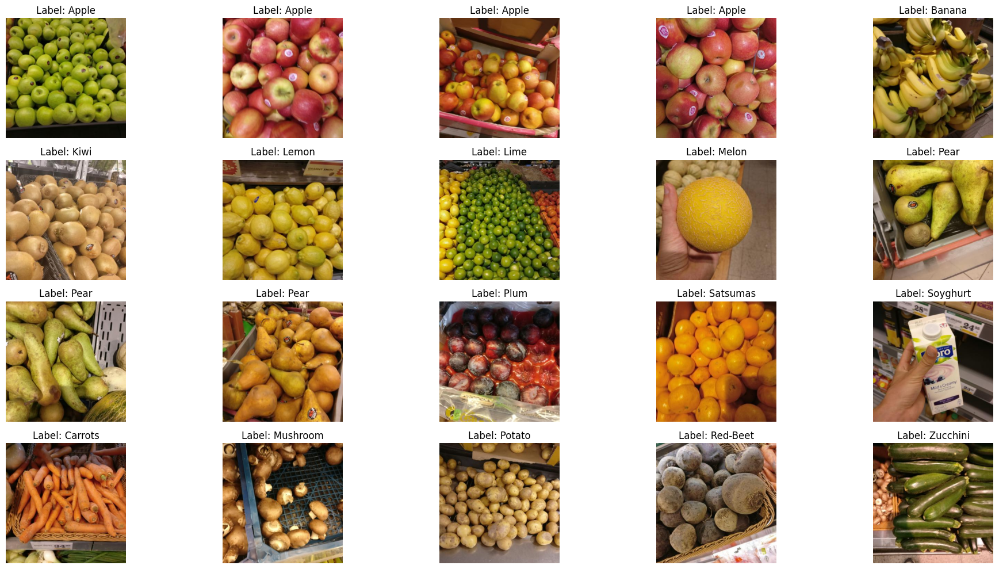

In [7]:
fix_random(seed=42)

num_images_to_show = 20
dataset = GroceryStoreDataset(split='train')

random_indices = random.sample(range(len(dataset)), num_images_to_show)
random_indices.sort()

plt.figure(figsize=(20, 10))
for i, idx in enumerate(random_indices):
    image, label = dataset[idx]
    plt.subplot(4, 5, i + 1)
    plt.imshow(image)
    plt.title(f"Label: {id_to_name[label]}")
    plt.axis('off')

plt.tight_layout()
plt.show()

### Transformation and data augmentation

In order to try to avoid overfitting, it is a good practice to add a transformation step. 

The transform operations are applied to the original images at every batch generation, meaning the images are transformed in every iteration. This ensures that the dataset remains unchanged, while the batch images are dynamically altered, providing a variety of inputs to the model during training preventing overfitting. 



Another crucial step is to carefully inspect the output of these transformations. A poorly designed transformation can lead to undesirable results, such as distorted images or loss of important features, which can negatively impact the model’s performance. Therefore, it is essential to validate that the transformations are applied correctly and that the augmented images still represent the original data accurately.



We are gonna perform this transformations:



  - `RandomHorizontalFlip()`: Randomly flips the image horizontally with a probability of 0.5, adding variability to the dataset.

  - `RandomRotation(90)`: Rotates the image by a random angle up to 90 degrees, helping the model become invariant to rotations.

  - `RandomResizedCrop(224, scale=(0.7, 1.0))`: Randomly crops the image to a size of 224x224 pixels, with the crop size ranging between 80% and 100% of the original dimensions, then resizes it to 224x224 pixels. This introduces variability in the cropping process. Extensive testing has shown that with a crop size from 80% to 100%, the subject of the image consistently remains part of the scene even after cropping.

  - `ToTensor()`: Converts the image to a PyTorch tensor, which is required for further processing in PyTorch models.
  - `Resize()`: Resizes the image to 256x256 pixels, ensuring a consistent input size for the model. 


In [8]:
# Define data augmentation transformations
sample_transforms = T.Compose([
    T.RandomHorizontalFlip(),
    T.RandomRotation(90),
    T.RandomResizedCrop(224, scale=(0.7, 1.0)),
    T.ToTensor(),
    T.Resize((224, 224)),
])

# Create dataset with transformations
transofrmed_data = GroceryStoreDataset(split='train', transform=sample_transforms)

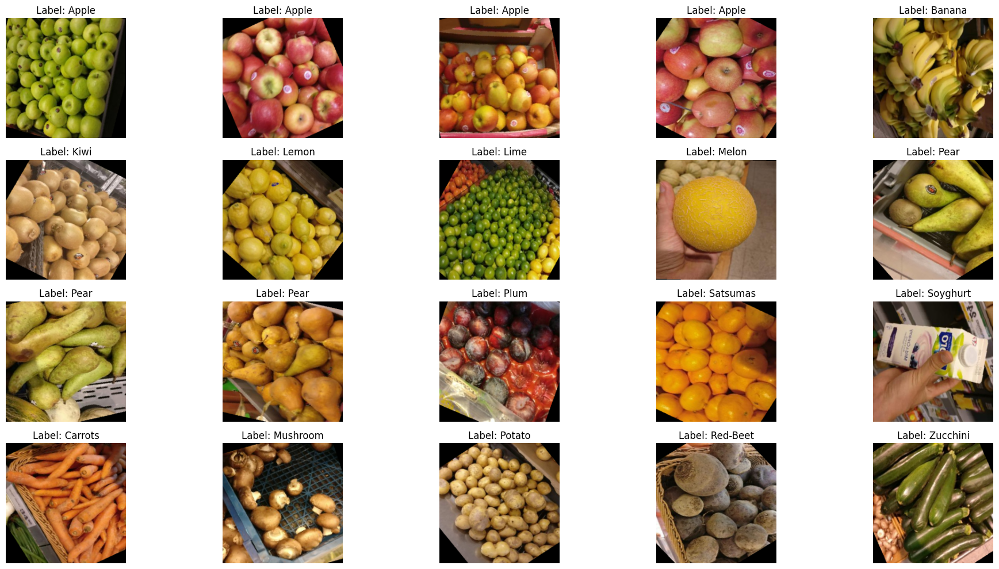

In [9]:
plt.figure(figsize=(20, 10))
for i, idx in enumerate(random_indices):
    image, label = transofrmed_data[idx]
    plt.subplot(4, 5, i + 1)
    plt.imshow(image.permute(1, 2, 0))
    plt.title(f"Label: {id_to_name[label]}")
    plt.axis('off')

plt.tight_layout()
plt.show()

#### Definition of the datasets and dataloaders 
For this procedure we used the following 2 hyperparameters
* **batch_size**. This parameter determines how many samples are processed before the model's internal parameters are updated. A batch size of 64 is chosen as it provides a good balance between computational efficiency and the model's ability to generalize.
* **image_size**. The images that will be used in both training and evaluating the network will be resized to the dimension: (image_size, image_size). The number of channels will remain 3, as we will use RGB images.


In [72]:
image_size = 224

train_transform = T.Compose([
    T.RandomHorizontalFlip(),
    T.RandomRotation(90),
    T.RandomResizedCrop(224, scale=(0.7, 1.0)),
    T.ToTensor(),
    T.Resize((image_size, image_size)),
])

basic_transform = T.Compose([
    T.ToTensor(),
    T.Resize((image_size, image_size)),
])

In [73]:
#Divide the dataset into training and test sets
train_dataset = GroceryStoreDataset("train", transform=train_transform)
test_dataset = GroceryStoreDataset("test", transform=basic_transform)
validation_dataset = GroceryStoreDataset("val", transform=basic_transform)

In [74]:
n_classes = train_dataset.get_num_classes()
print(f"There are {n_classes} classification categories")

There are 43 classification categories


In [75]:
batch_size = 64

#Define the loaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)

### Breakdown of the key technique used for the training 

In order to ensure a correct comparison of the following models for the training of each of them we are going to use the same train loop. The key technique used in the training loop are:

* **Cross Entropy Loss Function**: . It measures the difference between the predicted probability distribution and the true target distribution.
* **Optimizer**: AdamW. It is an widely used optimizer that combines the benefits of adaptive learning rates with effective weight decay, leading to potentially better generalization.
* **Training and Validation**: The function iterates through a specified number of epochs. Each epoch involves training the model on the training data (train_loader) and evaluating its 
* **Best Model Selection**: The model with the lowest validation loss is identified and saved as the "best model." This ensures selecting the model that performs best on unseen data (validation set).
* **Early stopping**: It is a technique used during training to halt the process when the model's performance on a validation set stops improving, preventing overfitting.
* **Learning rate scheduler**: Using a learning rate scheduler helps optimize the training process by adjusting the learning rate, preventing overshooting and improving convergence. We choose to use the The StepLR since it reduces the learning rate by a factor at specific intervals, which can help in fine-tuning the model’s performance as training progresses.
* **Data visualization**: In order be sure on what the model is being trained on and to verify the effectiveness of data augmentation, we visualize the first n elements taken from the training set after a specified number of epochs.
 
#### Breakdown of the key hyperparameters:

* **num_epochs**. This specifies the number of complete passes through the training dataset.
* **learning_rate**. The learning rate controls how much the model's weights are adjusted in response to the estimated error each time the model weights are updated.
* **hidden_dim**. This defines the size of the hidden layer in the fully connected part of the network. 
* **verbose**. If True, will show informations about training progression.
* **dropout**. It is a regularization technique that prevents overfitting by randomly setting a fraction of the neurons to zero during training.
* **patience**. Represents the number of epochs after which the training will be stopped if no improvement in validation loss is detected
* **min_delta**. It represents the the minimum change in validation loss that qualifies as an improvement.

### First Network - (First attempt)
As a first attempt, we aim to create a simple convolutional neural network (CNN) inspired by the VGG architecture. Similar to VGG, this CNN: 

Similar to VGG, this CNN:

   - **Lacks a stem layer**: It does not include an initial preprocessing layer.
   - **Has a regular design**: The network is composed of stages that follow the same structure.
   - **Uses only 3x3 convolutions**: All convolutional layers have a kernel size of 3x3.
   - **Doubles the number of channels after each stage**: The number of feature maps is increased by a factor of two after each stage.
   - **Halves the spatial dimensions after each stage**: The spatial resolution of the feature maps is reduced by half after each stage, typically through max-pooling layers.


#### Stage Construction
Each stage in the network is defined by the ConvoStage class, which consists of the following components:

1. **Convolutional Layer**: Applies a convolution with a kernel size of 3x3, specified input and output channels, stride of 1, and padding of 1. This layer extracts features from the input image and double the number of channels after each convolution.
2. **ReLU Activation**: Applies the ReLU activation function to introduce non-linearity into the model, helping it learn complex patterns.
3. **Max Pooling Layer**: Reduces the spatial dimensions (height and width) of the feature maps by half, using a 2x2 kernel with a stride of 2. This helps in down-sampling the feature maps, reducing the computational load and controlling overfitting.



In [14]:
class ConvoStage(nn.Module): 
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1):
        super().__init__()
        self.conv = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding)
        self.relu = nn.ReLU()
        self.MaxPool = nn.MaxPool2d(kernel_size=2, stride=2)
    
    def forward(self, x):
        x = self.conv(x)
        x = self.relu(x)
        x = self.MaxPool(x)
        return x

#### First Network Overview

The ConvolNet class defines the overall structure of the network:

1. **Stage 1**: Consists of a ConvoStage that takes an input with 3 channels (e.g., an RGB image) and outputs 16 channels.
2. **Stage 2**: Another ConvoStage that takes the 16-channel output from Stage 1 and produces 32 channels.
3. **Flattening**: After the convolutional stages, the network flattens the output and passes it through fully connected layers:
4. **Fully Connected Layer**: The first fully connected layer reduces the flattened feature map to the specified hidden dimension. After some test we found out that am hiddem dimension of 256 was enought to achive good performaces of the net while keeping the network small
5. **ReLU Activation and Dropout**: Applies ReLU activation followed by dropout to prevent overfitting.
6. **Output Layer**: The final fully connected layer maps the hidden dimension to the number of classes for classification.


In [15]:
class ConvolNet(nn.Module):

    def __init__(self, hidden_dim, n_classes, dropout = 0.5):

        super().__init__()
        
        self.stage1 = ConvoStage(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.stage2 = ConvoStage(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)
        
        last_conv_output_size = 100352 #computed parameter 

        # Initialize the fully connected layers
        self.first = nn.Linear(last_conv_output_size, hidden_dim)
        self.relu = nn.ReLU()
        self.last = nn.Linear(hidden_dim, n_classes)
        self.drop = nn.Dropout(dropout)
        


    def forward(self, x):
        
        #stage 1
        x = self.stage1(x)
        #stage 2
        x = self.stage2(x)
        #classifier
        x = torch.flatten(x, 1)
        x = self.drop(self.relu(self.first(x)))
        x = self.last(x)
        
        return x

In [16]:
#define the first model
hidden_dim = 256
dropout = 0.5

first_model= ConvolNet(
    hidden_dim,
    n_classes,
    dropout = dropout
)

print(first_model)

ConvolNet(
  (stage1): ConvoStage(
    (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage2): ConvoStage(
    (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (first): Linear(in_features=100352, out_features=256, bias=True)
  (relu): ReLU()
  (last): Linear(in_features=256, out_features=43, bias=True)
  (drop): Dropout(p=0.5, inplace=False)
)


#### Training of the first network 

  0%|          | 0/30 [00:00<?, ?it/s]

First 5 images of the epoch:


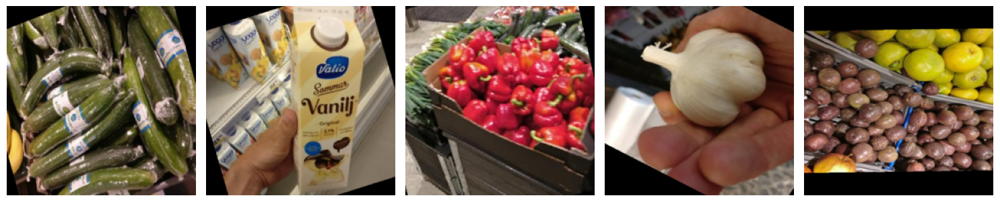

Epoch 0: lr 0.001 - train loss 3.632 - train acc 0.108 - valid loss 3.136 - valid acc 0.159
Epoch 0: best acc 0.159
Epoch 3: lr 0.001 - train loss 2.588 - train acc 0.254 - valid loss 2.630 - valid acc 0.247
Epoch 3: best acc 0.247
Epoch 6: lr 0.001 - train loss 2.167 - train acc 0.335 - valid loss 2.277 - valid acc 0.307
Epoch 6: best acc 0.307
Epoch 9: lr 0.0001 - train loss 1.828 - train acc 0.426 - valid loss 2.262 - valid acc 0.297
Epoch 9: best acc 0.307
First 5 images of the epoch:


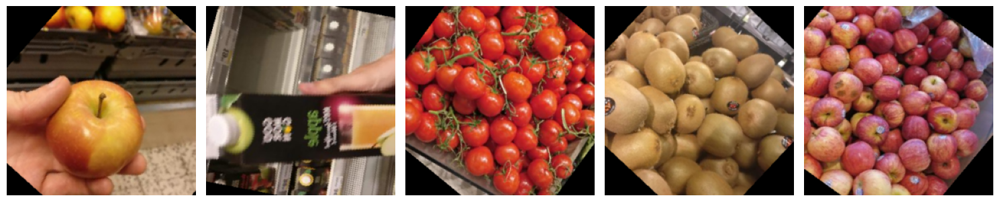

Epoch 12: lr 0.0001 - train loss 1.626 - train acc 0.456 - valid loss 2.108 - valid acc 0.355
Epoch 12: best acc 0.355
Epoch 15: lr 0.0001 - train loss 1.609 - train acc 0.476 - valid loss 2.081 - valid acc 0.341
Epoch 15: best acc 0.372
Epoch 18: lr 0.0001 - train loss 1.561 - train acc 0.503 - valid loss 2.115 - valid acc 0.321
Epoch 18: best acc 0.372
First 5 images of the epoch:


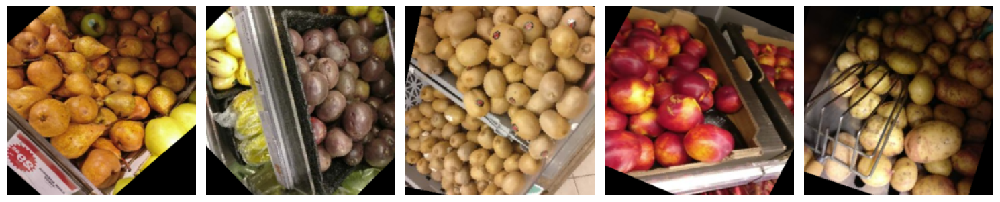

Epoch 21: lr 1e-05 - train loss 1.559 - train acc 0.486 - valid loss 2.044 - valid acc 0.351
Epoch 21: best acc 0.372
Early stopping at epoch 25
Best epoch 14, best acc 0.3716216216216216


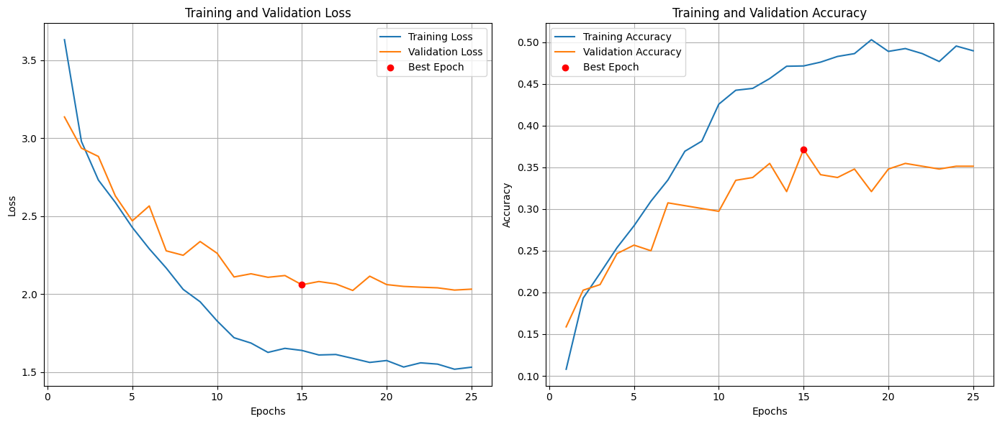

In [17]:
learning_rate = 1e-3
num_epochs = 30
min_delta = 0
patience = 7
verbose=True

fix_random(seed=42)
optimizer = torch.optim.AdamW(first_model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=10, gamma=0.1)

best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_pipeline(
    first_model,
    train_loader,
    num_epochs,
    validation_loader,
    verbose,
    optimizer,
    patience=patience,
    min_delta=min_delta, 
    scheduler = scheduler
)

plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)

In [18]:
model_export_path = "models"
model_name = "first_model"
save_net(first_model,model_export_path, model_name)
test_model(first_model, test_loader)

Model first_model saved correctly
Accuracy of the network on the test images: 46.48%


46.478873239436616

#### Evaluation of the first model
This network easily achives a **37.1%** accuracy on the validation set and a **46.4%** accuracy on the test set. This result is gonna be took as baseline for the evaluation of the next networks. 

### Second Net - (Introdution of the Global Aberage Pooling)
The primary difference between the original network (`ConvolNet`) and the new network (`GAPNetwork`) lies in the use of Global Average Pooling (GAP) in the latter. This is gonna allow us to reach the same accuracy with a fraction of the count of the previus parameter.

#### Counts of the parameters
The `ConvolNet` and the `GAPNetwork` have the same exact first 2 stages, so there the amout of parameter is gonna be the same. 

The big difference happens at the beginning of the classifier. Using a normal fully connected layer we are gonna need to flatter the result of the second stage and to do so we are gonna create a fully connected layer of **100352 elements**. 

In the second network we introduced a global average pooling layer after the convolutional stages. This layer reduces each feature map to a single value by averaging all the values in the feature map, significantly reducing the number of parameters by reducing the spatial dimensions of the feature maps before they are passed to the fully connected layers. In ur case the output of the global average pooling is an 8x8 feature map with 32 channels, the flattened output will only have (8 * 8 * 32 = ) **2048 elements**. 

We also tried using a feature map of 1x1, but this resulted in a poorly performing network. Our intuition is that with only 32 channels, a feature map of 1x1 is not enough because it drastically reduces the amount of information available for the classifier. The 1x1 feature map compresses the spatial information too much, leading to a significant loss of detail and context that the classifier needs to make accurate predictions.

This approach highlights the trade-off between parameter count and network performance.

In [19]:
class GAPNetwork(nn.Module):

    def __init__(self, hidden_dim, n_classes, dropout =0.5):
        super().__init__()

        self.stage1 = ConvoStage(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.stage2 = ConvoStage(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)

        self.global_avg_pool = nn.AdaptiveAvgPool2d((8, 8))

        last_conv_output_channels = 2048  # Adjust based on your last global_avg_pool output

        self.first = nn.Linear(last_conv_output_channels, hidden_dim)
        self.last = nn.Linear(hidden_dim, n_classes)
        self.drop = nn.Dropout(dropout)
        self.relu = nn.ReLU()

    def forward(self, x):
        
        #stage 1
        x = self.stage1(x)
        #stage 2
        x = self.stage2(x)
        
        #classifier
        x = self.global_avg_pool(x)
        x = torch.flatten(x, 1)
        x = self.drop(self.relu(self.first(x)))
        x = self.last(x)

        return x


GAPNetwork(
  (stage1): ConvoStage(
    (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage2): ConvoStage(
    (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (global_avg_pool): AdaptiveAvgPool2d(output_size=(8, 8))
  (first): Linear(in_features=2048, out_features=256, bias=True)
  (last): Linear(in_features=256, out_features=43, bias=True)
  (drop): Dropout(p=0.5, inplace=False)
  (relu): ReLU()
)


  0%|          | 0/40 [00:00<?, ?it/s]

First 5 images of the epoch:


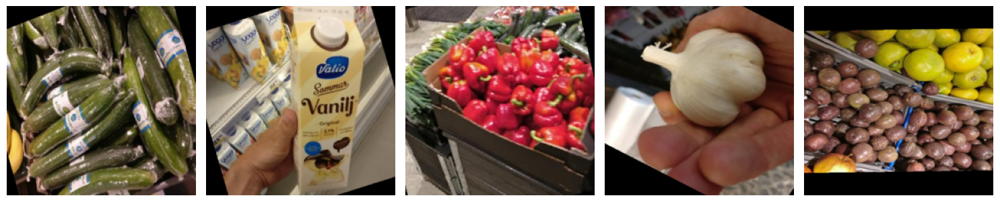

Epoch 0: lr 0.001 - train loss 3.451 - train acc 0.103 - valid loss 3.319 - valid acc 0.118
Epoch 0: best acc 0.118
Epoch 3: lr 0.001 - train loss 2.665 - train acc 0.241 - valid loss 2.778 - valid acc 0.236
Epoch 3: best acc 0.236
Epoch 6: lr 0.001 - train loss 2.218 - train acc 0.321 - valid loss 2.433 - valid acc 0.274
Epoch 6: best acc 0.284
Epoch 9: lr 0.001 - train loss 1.948 - train acc 0.376 - valid loss 2.102 - valid acc 0.324
Epoch 9: best acc 0.324
First 5 images of the epoch:


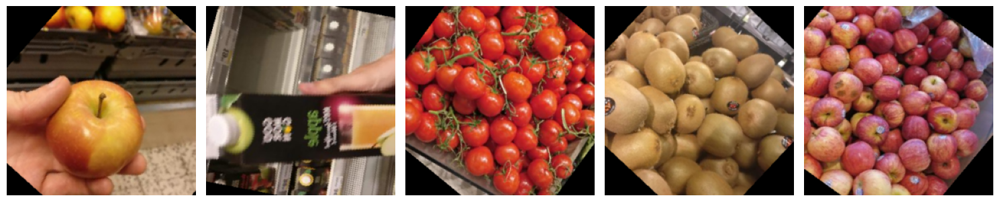

Epoch 12: lr 0.001 - train loss 1.771 - train acc 0.424 - valid loss 2.047 - valid acc 0.351
Epoch 12: best acc 0.351
Epoch 15: lr 0.001 - train loss 1.642 - train acc 0.456 - valid loss 2.048 - valid acc 0.365
Epoch 15: best acc 0.365
Epoch 18: lr 0.001 - train loss 1.517 - train acc 0.484 - valid loss 2.119 - valid acc 0.365
Epoch 18: best acc 0.365
First 5 images of the epoch:


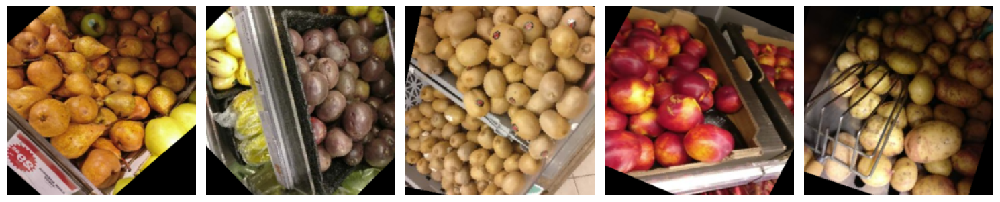

Epoch 21: lr 0.0001 - train loss 1.395 - train acc 0.529 - valid loss 1.993 - valid acc 0.372
Epoch 21: best acc 0.389
Epoch 24: lr 0.0001 - train loss 1.350 - train acc 0.548 - valid loss 1.968 - valid acc 0.365
Epoch 24: best acc 0.392
Epoch 27: lr 0.0001 - train loss 1.329 - train acc 0.541 - valid loss 1.983 - valid acc 0.365
Epoch 27: best acc 0.392
First 5 images of the epoch:


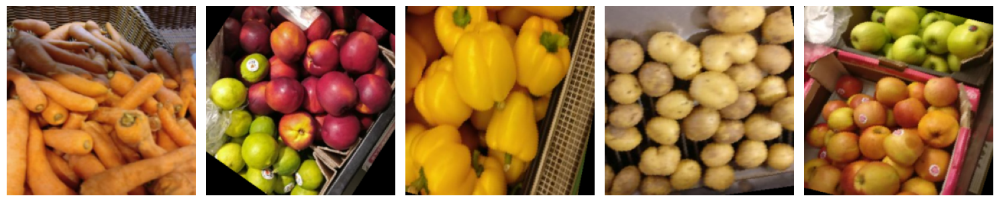

Epoch 30: lr 0.0001 - train loss 1.322 - train acc 0.551 - valid loss 1.976 - valid acc 0.368
Epoch 30: best acc 0.392
Early stopping at epoch 34
Best epoch 23, best acc 0.3918918918918919


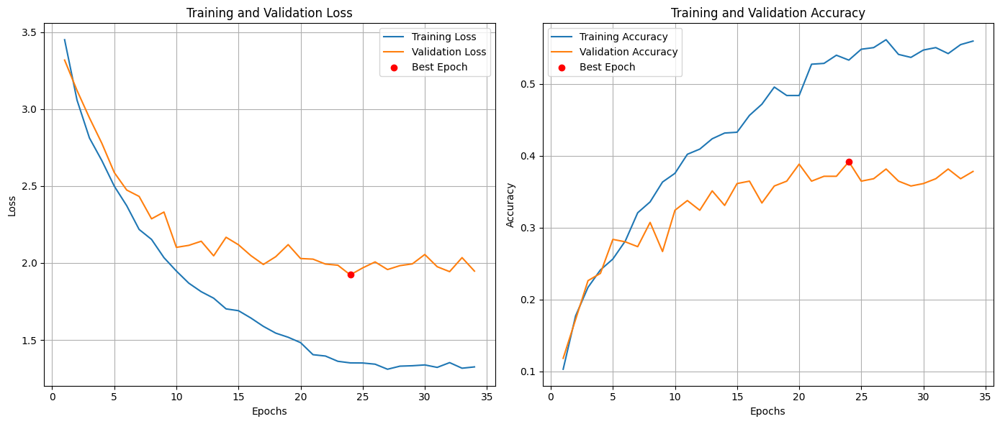

In [20]:
hidden_dim = 256
dropout = 0.5

second_model = GAPNetwork(
    hidden_dim,
    n_classes,
    dropout = dropout
)

print(second_model)

learning_rate = 1e-3
#40 ep sembrano essere un po troppe
num_epochs = 40
patience = 10

fix_random(seed=42)

optimizer = torch.optim.AdamW(second_model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=20, gamma=0.1)
#step size can be reduced to 15

best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs= train_pipeline(second_model,
                                                       train_loader,
                                                       num_epochs,
                                                       validation_loader,
                                                       verbose,
                                                       optimizer,
                                                       patience=patience,
                                                       min_delta=min_delta,
                                                       scheduler=scheduler)

plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)

In [21]:
model_name = "second_model"
save_net(second_model,model_export_path, model_name)
test_model(second_model, test_loader)

Model second_model saved correctly
Accuracy of the network on the test images: 47.28%


47.283702213279675

#### Evaluation of the second model
This network achieves a **39.1%** accuracy on the validation set and a **47.3%** accuracy on the test set, reaching slightly better performance of the first network while using significantly fewer parameters.

### Third model - (Problem with the training of deeper networks)
Starting with just a few stages, the initial model achieves around 40% accuracy on the validation dataset. To enhance this performance, we plan to increase the network’s depth by adding two additional stages. These new stages will follow the same pattern as the previous ones, where the spatial dimensions are halved and the number of channels is doubled after each stage.
Doing so we expet a general improvement of the performance.

In [ ]:
class LargeGAPNet(nn.Module):

    def __init__(self, hidden_dim, n_classes, dropout =0.5):
        super().__init__()
        
        self.stage1 = ConvoStage(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.stage2 = ConvoStage(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.stage3 = ConvoStage(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.stage4 = ConvoStage(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1)
        
        self.global_avg_pool = nn.AdaptiveAvgPool2d((1, 1))
        last_conv_output_channels = 128
        self.first = nn.Linear(last_conv_output_channels, hidden_dim)
        self.last = nn.Linear(hidden_dim, n_classes)
        self.drop = nn.Dropout(dropout)
        self.relu = nn.ReLU()

    def forward(self, x):
       
        #stage 1 3->16
        x = self.stage1(x)
        #stage 2 16->32
        x = self.stage2(x)
        #stage 3 32->64
        x = self.stage3(x)
        #stage 64->128
        x = self.stage4(x)
        
        # Classifier
        x = self.global_avg_pool(x)
        x = torch.flatten(x, 1)
        x = self.drop(self.relu(self.first(x)))
        x = self.last(x)
        return x

LargeGAPNet(
  (stage1): ConvoStage(
    (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage2): ConvoStage(
    (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage3): ConvoStage(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage4): ConvoStage(
    (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (global_avg_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (first): Linear(in_features=128, out_features=256, bias=True)
  (l

  0%|          | 0/40 [00:00<?, ?it/s]

First 5 images of the epoch:


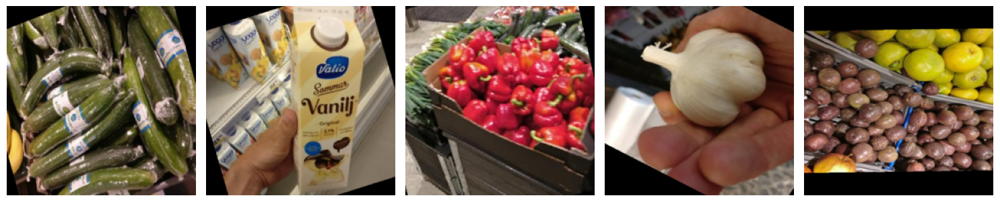

Epoch 0: lr 0.001 - train loss 3.523 - train acc 0.103 - valid loss 3.503 - valid acc 0.074
Epoch 0: best acc 0.074
Epoch 3: lr 0.001 - train loss 3.205 - train acc 0.162 - valid loss 3.144 - valid acc 0.169
Epoch 3: best acc 0.169
Epoch 6: lr 0.001 - train loss 2.797 - train acc 0.209 - valid loss 2.903 - valid acc 0.230
Epoch 6: best acc 0.230
Epoch 9: lr 0.001 - train loss 2.606 - train acc 0.235 - valid loss 3.136 - valid acc 0.193
Epoch 9: best acc 0.230
First 5 images of the epoch:


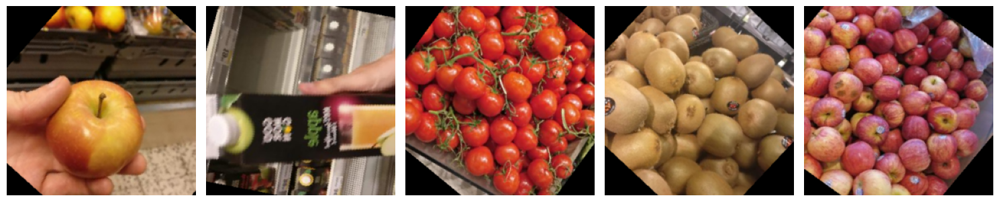

Epoch 12: lr 0.001 - train loss 2.484 - train acc 0.264 - valid loss 2.768 - valid acc 0.230
Epoch 12: best acc 0.230
Epoch 15: lr 0.001 - train loss 2.318 - train acc 0.309 - valid loss 2.715 - valid acc 0.274
Epoch 15: best acc 0.274
Epoch 18: lr 0.001 - train loss 2.134 - train acc 0.332 - valid loss 2.484 - valid acc 0.301
Epoch 18: best acc 0.301
First 5 images of the epoch:


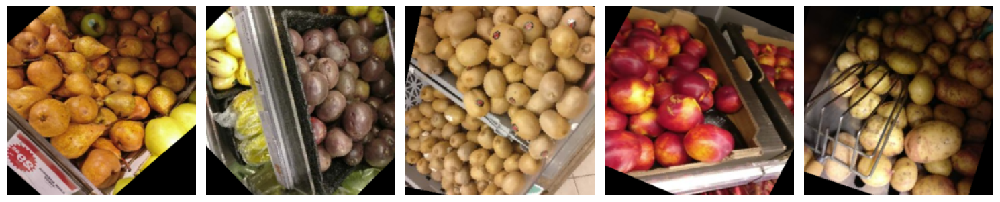

Epoch 21: lr 0.001 - train loss 1.937 - train acc 0.386 - valid loss 2.768 - valid acc 0.280
Epoch 21: best acc 0.301
Epoch 24: lr 0.001 - train loss 1.702 - train acc 0.457 - valid loss 3.212 - valid acc 0.206
Epoch 24: best acc 0.301
Epoch 27: lr 0.001 - train loss 1.505 - train acc 0.511 - valid loss 3.018 - valid acc 0.247
Epoch 27: best acc 0.301
First 5 images of the epoch:


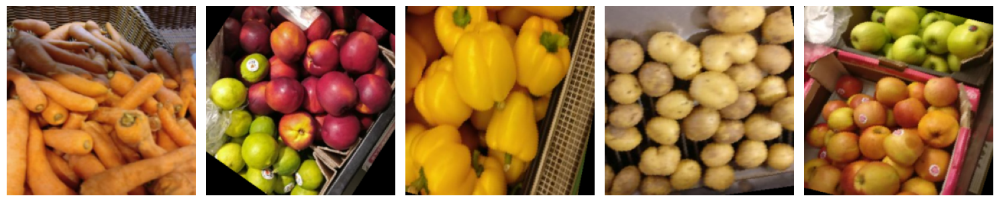

Epoch 30: lr 1e-05 - train loss 1.372 - train acc 0.551 - valid loss 2.584 - valid acc 0.314
Epoch 30: best acc 0.358
Epoch 33: lr 1e-05 - train loss 1.304 - train acc 0.567 - valid loss 2.637 - valid acc 0.311
Epoch 33: best acc 0.358
Epoch 36: lr 1e-05 - train loss 1.280 - train acc 0.586 - valid loss 2.636 - valid acc 0.314
Epoch 36: best acc 0.358
Early stopping at epoch 39
Best epoch 28, best acc 0.3581081081081081


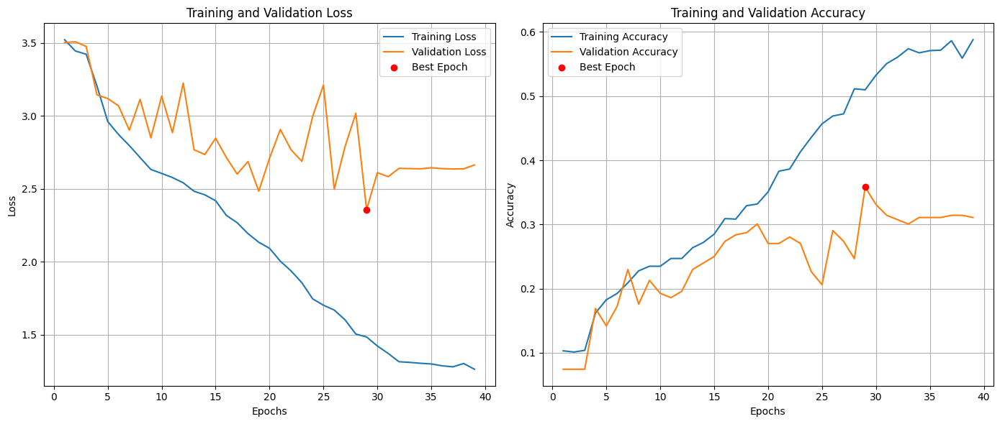

In [ ]:
#hyperparameters
hidden_dim = 256
num_epochs = 40
learning_rate = 1e-3
dropout = 0.5
min_delta = 0.001
patience = 10
verbose=True
step_size = 30
#40 proven to be decent, try 30

# Instantiate model
third_model = LargeGAPNet(
    hidden_dim,
    n_classes,
    dropout = dropout
)

print(third_model)

fix_random(seed=42)
optimizer = torch.optim.AdamW(third_model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=step_size, gamma=0.01)

best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs= train_pipeline(third_model,
                                                        train_loader,
                                                        num_epochs,
                                                        validation_loader,
                                                        verbose,
                                                        optimizer,
                                                        patience=patience,
                                                        min_delta=min_delta, 
                                                        scheduler=scheduler)

plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)

In [ ]:
model_name = "third_model v1"
save_net(third_model,model_export_path, model_name)
test_model(third_model, test_loader)

Accuracy of the network on the test images: 47.28%


47.283702213279675

#### Evaluation of the third model 

This network achieves a **35.8%** accuracy on the validation set and a **47.3%** accuracy on the test set. This mark no improvements from the previus network (previusly was 39.1% and 47.3%) but the training plots clearly indicate that there are issues with the model’s training process. Despite the `LargeGAPNet` potential to achieve significantly better performance, the accuracy on the validation and test datasets remains similar to that of the much smaller `GAPNetwork` (Second network).

Adding layers is not always the best choice, as deeper convolutional neural networks (CNNs) are challenging to train. They can suffer from vanishing or exploding gradients, which hinder the network’s ability to learn effectively as its depth increases.

### Third model v.2 - (Introdution of the Batch Normalization Layer)

In order to solve the problem with the `LargeGAPNet` we introduce the a **Batch Normalization** 

Batch Normalization, often referred to as batch norm, is a technique that accelerates and stabilizes the training of artificial neural networks. By normalizing the inputs of each layer, it stabilizes the learning process, enabling faster and more reliable training of deeper networks.

To implement this, we create the `ConvoStageBN` module. This module has the same structure as the `ConvoStage` module, with the only modification being the addition of a Batch Normalization layer immediately after each Convolution layer.

We also reduced the learning rate to further stabilize the training process. A lower learning rate helps in fine-tuning the model by making smaller updates to the weights, which can prevent overshooting the optimal parameters and lead to more precise convergence. This adjustment is particularly beneficial when introducing new layers like Batch Normalization, as it allows the model to adapt more smoothly to the changes.

In [25]:
class ConvoStageBN(nn.Module): 
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1):
        super().__init__()
        self.conv = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()
        self.MaxPool = nn.MaxPool2d(kernel_size=2, stride=2)
    
    def forward(self, x):
        x = self.conv(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.MaxPool(x)
        return x

In [ ]:
class LargeGAPNet(nn.Module):

    def __init__(self, hidden_dim, n_classes, dropout=0.5):
        super().__init__()
        
        self.stage1 = ConvoStageBN(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.stage2 = ConvoStageBN(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.stage3 = ConvoStageBN(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.stage4 = ConvoStageBN(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1)
        
        self.global_avg_pool = nn.AdaptiveAvgPool2d((1, 1))
        last_conv_output_channels = 128
        self.first = nn.Linear(last_conv_output_channels, hidden_dim)
        self.last = nn.Linear(hidden_dim, n_classes)
        self.drop = nn.Dropout(dropout)
        self.relu = nn.ReLU()

    def forward(self, x):
       
        #stage 1 3->16
        x = self.stage1(x)
        #stage 2 16->32
        x = self.stage2(x)
        #stage 3 32->64
        x = self.stage3(x)
        #stage 64->128
        x = self.stage4(x)
        
        # Apply global average pooling
        x = self.global_avg_pool(x)
        x = torch.flatten(x, 1)
        x = self.drop(self.relu(self.first(x)))
        x = self.last(x)
        return x

LargeGAPNet(
  (stage1): ConvoStageBN(
    (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage2): ConvoStageBN(
    (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage3): ConvoStageBN(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage4): ConvoStageBN(
    (conv): Conv2d(64, 128, kernel_siz

  0%|          | 0/60 [00:00<?, ?it/s]

First 5 images of the epoch:


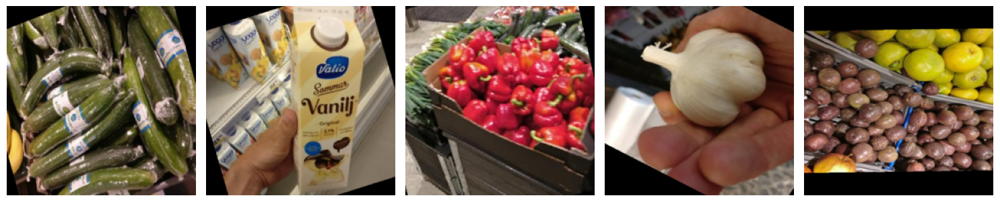

Epoch 0: lr 0.0001 - train loss 3.579 - train acc 0.101 - valid loss 3.564 - valid acc 0.176
Epoch 0: best acc 0.176
Epoch 3: lr 0.0001 - train loss 2.873 - train acc 0.258 - valid loss 2.963 - valid acc 0.230
Epoch 3: best acc 0.230
Epoch 6: lr 0.0001 - train loss 2.545 - train acc 0.315 - valid loss 2.726 - valid acc 0.280
Epoch 6: best acc 0.280
Epoch 9: lr 0.0001 - train loss 2.292 - train acc 0.353 - valid loss 2.478 - valid acc 0.297
Epoch 9: best acc 0.314
First 5 images of the epoch:


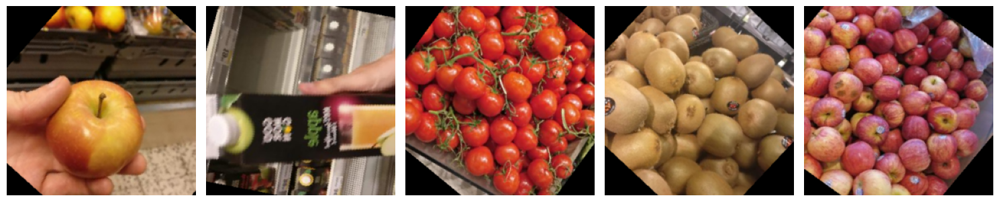

Epoch 12: lr 0.0001 - train loss 2.089 - train acc 0.408 - valid loss 2.358 - valid acc 0.355
Epoch 12: best acc 0.361
Epoch 15: lr 0.0001 - train loss 1.944 - train acc 0.417 - valid loss 2.132 - valid acc 0.385
Epoch 15: best acc 0.385
Epoch 18: lr 0.0001 - train loss 1.771 - train acc 0.467 - valid loss 2.029 - valid acc 0.412
Epoch 18: best acc 0.412
First 5 images of the epoch:


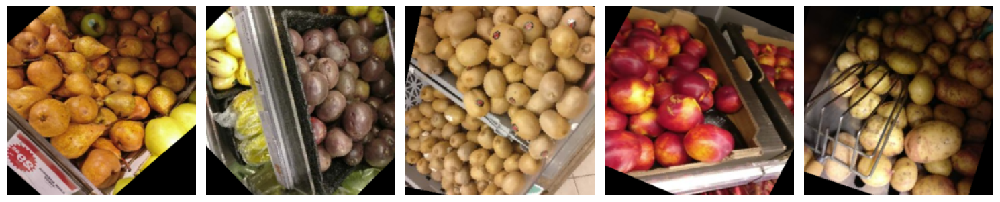

Epoch 21: lr 0.0001 - train loss 1.668 - train acc 0.492 - valid loss 2.001 - valid acc 0.405
Epoch 21: best acc 0.432
Epoch 24: lr 0.0001 - train loss 1.574 - train acc 0.518 - valid loss 1.923 - valid acc 0.436
Epoch 24: best acc 0.436
Epoch 27: lr 0.0001 - train loss 1.506 - train acc 0.527 - valid loss 1.913 - valid acc 0.446
Epoch 27: best acc 0.459
First 5 images of the epoch:


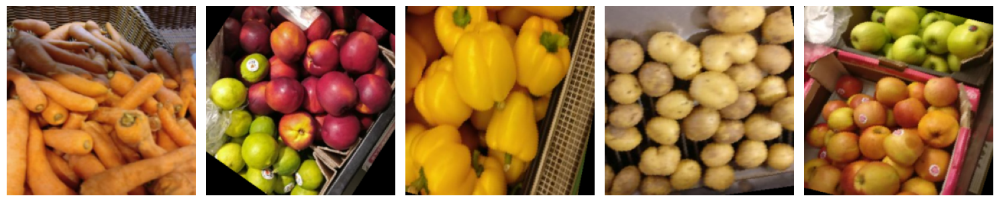

Epoch 30: lr 0.0001 - train loss 1.426 - train acc 0.545 - valid loss 1.805 - valid acc 0.466
Epoch 30: best acc 0.466
Epoch 33: lr 0.0001 - train loss 1.341 - train acc 0.577 - valid loss 1.822 - valid acc 0.459
Epoch 33: best acc 0.466
Epoch 36: lr 0.0001 - train loss 1.287 - train acc 0.597 - valid loss 1.834 - valid acc 0.449
Epoch 36: best acc 0.473
Epoch 39: lr 0.0001 - train loss 1.238 - train acc 0.606 - valid loss 1.769 - valid acc 0.456
Epoch 39: best acc 0.473
First 5 images of the epoch:


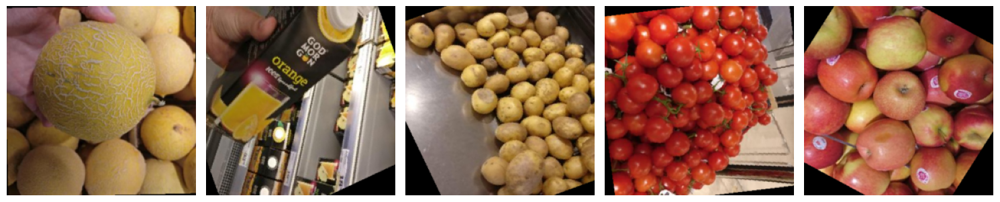

Epoch 42: lr 0.0001 - train loss 1.172 - train acc 0.622 - valid loss 1.696 - valid acc 0.470
Epoch 42: best acc 0.473
Epoch 45: lr 0.0001 - train loss 1.123 - train acc 0.644 - valid loss 1.665 - valid acc 0.493
Epoch 45: best acc 0.493
Epoch 48: lr 0.0001 - train loss 1.105 - train acc 0.646 - valid loss 1.636 - valid acc 0.483
Epoch 48: best acc 0.507
First 5 images of the epoch:


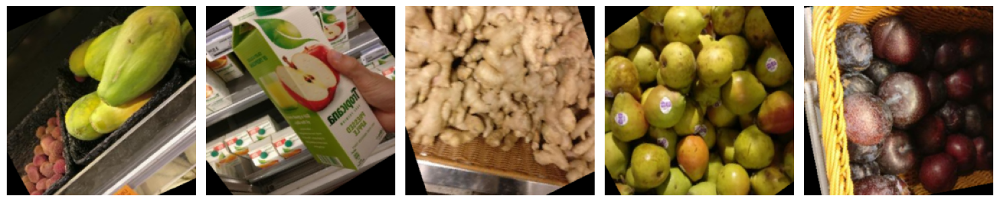

Epoch 51: lr 1e-05 - train loss 1.040 - train acc 0.663 - valid loss 1.557 - valid acc 0.507
Epoch 51: best acc 0.534
Epoch 54: lr 1e-05 - train loss 1.025 - train acc 0.667 - valid loss 1.560 - valid acc 0.497
Epoch 54: best acc 0.534
Epoch 57: lr 1e-05 - train loss 1.011 - train acc 0.677 - valid loss 1.541 - valid acc 0.510
Epoch 57: best acc 0.534
Best epoch 49, best acc 0.5337837837837838


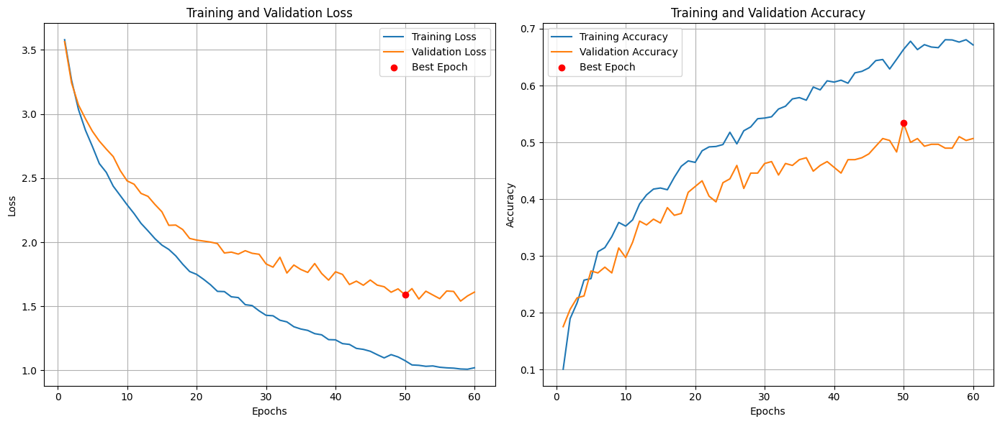

In [ ]:
batch_size = 64
num_epochs = 60
learning_rate = 1e-4
hidden_dim = 256
verbose=True
dropout = 0.5
patience = 20

# Instantiate model
third_model_v2 = LargeGAPNet(
    hidden_dim,
    n_classes,
    dropout = dropout
)

print(third_model_v2)

fix_random(seed=42)
optimizer = torch.optim.AdamW(third_model_v2.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=50, gamma=0.1)
#change step with 20

best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs= train_pipeline(third_model_v2,
                                                        train_loader,
                                                        num_epochs,
                                                        validation_loader,
                                                        verbose,
                                                        optimizer,
                                                        patience=patience,
                                                        min_delta=min_delta, 
                                                        scheduler=scheduler)

plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)

In [28]:
model_name = "third_model v2"
save_net(third_model_v2, model_export_path, model_name)
test_model(third_model_v2, test_loader)

Model third_model v2 saved correctly
Accuracy of the network on the test images: 58.63%


58.6317907444668

#### Evaluation of the Third model v.2
Examining the training statistics plot, it is immediately evident that the Batch Normalization (BN) layer significantly aids in regularizing the network’s training, as anticipated. Thanks only to this addition we are able to easily achive a **53.3% accuracy on the validation dataset and a 58.6% accuracy on the test dataset**. This marks a substantial improvement, **nearly 15% higher accuracy**
on the validation dataset compared to the previous network that did not utilize batch normalization.

### Fourth model - (Definition of the final model)
To achieve a 60% accuracy on the validation set, we **enhanced our network by doubling the number of channels** in each layer and adding a final convolutional stage. This improvement enables the network to capture more detailed and abstract features, leading to better performance on the validation dataset.

The intuition behind this choice was that increasing the number of channels in each convolutional layer allows the network to learn a richer and more diverse set of features. This enhancement improves the network’s ability to distinguish between classes and is particularly advantageous for deeper networks, as it helps preserve important information across layers.

Additionally, we **increased the hidden dimension parameter from 256 to 1024**. This change allows the network to capture and represent more complex patterns and relationships in the data, providing more capacity for learning and storing information. As a result, the network’s ability to generalize and make accurate predictions is improved, leading to better overall performance

In [ ]:
class DefNet(nn.Module):

    def __init__(self, hidden_dim, n_classes, dropout=0.5):
        super().__init__()
        
        self.stage1 = ConvoStageBN(in_channels=3, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.stage2 = ConvoStageBN(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.stage3 = ConvoStageBN(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1)
        self.stage4 = ConvoStageBN(in_channels=128, out_channels=256, kernel_size=3, stride=1, padding=1)
        self.stage5 = ConvoStageBN(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1)

        self.global_avg_pool = nn.AdaptiveAvgPool2d((1, 1))

        last_conv_output_channels = 256
        self.first = nn.Linear(last_conv_output_channels, hidden_dim)
        self.last = nn.Linear(hidden_dim, n_classes)
        self.drop = nn.Dropout(dropout)
        self.relu = nn.ReLU()

    def forward(self, x):

        x = self.stage1(x)
        x = self.stage2(x)
        x = self.stage3(x)
        x = self.stage4(x)
        x = self.stage5(x)

        # Apply global average pooling
        x = self.global_avg_pool(x)
        x = torch.flatten(x, 1)
        x = self.drop(self.relu(self.first(x)))
        x = self.last(x)

        return x

In [30]:
batch_size = 64
#num_epochs = 60 #functioning
num_epochs = 40
learning_rate = 1e-4
hidden_dim = 1024
verbose=True
dropout = 0.5
patience = 20

model = DefNet(
    hidden_dim,
    n_classes,
    dropout = dropout
)

print(model)

DefNet(
  (stage1): ConvoStageBN(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage2): ConvoStageBN(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage3): ConvoStageBN(
    (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage4): ConvoStageBN(
    (conv): Conv2d(128, 256, kernel_size=

  0%|          | 0/40 [00:00<?, ?it/s]

First 5 images of the epoch:


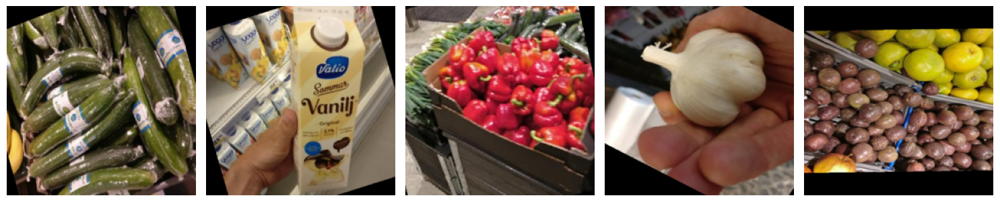

Epoch 0: lr 0.0001 - train loss 3.190 - train acc 0.203 - valid loss 3.270 - valid acc 0.166
Epoch 0: best acc 0.166
Epoch 3: lr 0.0001 - train loss 1.922 - train acc 0.456 - valid loss 2.188 - valid acc 0.392
Epoch 3: best acc 0.392
Epoch 6: lr 0.0001 - train loss 1.379 - train acc 0.578 - valid loss 2.003 - valid acc 0.402
Epoch 6: best acc 0.412
Epoch 9: lr 0.0001 - train loss 1.081 - train acc 0.666 - valid loss 1.739 - valid acc 0.486
Epoch 9: best acc 0.486
First 5 images of the epoch:


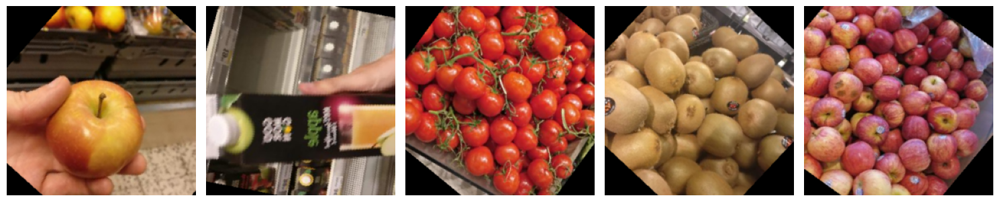

Epoch 12: lr 0.0001 - train loss 0.833 - train acc 0.753 - valid loss 1.717 - valid acc 0.480
Epoch 12: best acc 0.557
Epoch 15: lr 0.0001 - train loss 0.718 - train acc 0.783 - valid loss 1.412 - valid acc 0.541
Epoch 15: best acc 0.571
Epoch 18: lr 0.0001 - train loss 0.599 - train acc 0.816 - valid loss 1.523 - valid acc 0.503
Epoch 18: best acc 0.591
First 5 images of the epoch:


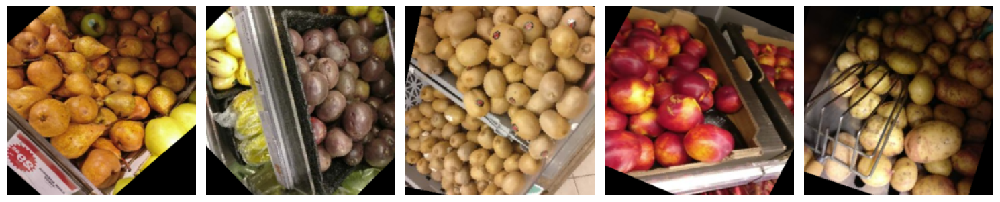

Epoch 21: lr 0.0001 - train loss 0.500 - train acc 0.858 - valid loss 1.547 - valid acc 0.527
Epoch 21: best acc 0.591
Epoch 24: lr 0.0001 - train loss 0.436 - train acc 0.882 - valid loss 1.319 - valid acc 0.595
Epoch 24: best acc 0.605
Epoch 27: lr 0.0001 - train loss 0.423 - train acc 0.873 - valid loss 1.658 - valid acc 0.601
Epoch 27: best acc 0.605
First 5 images of the epoch:


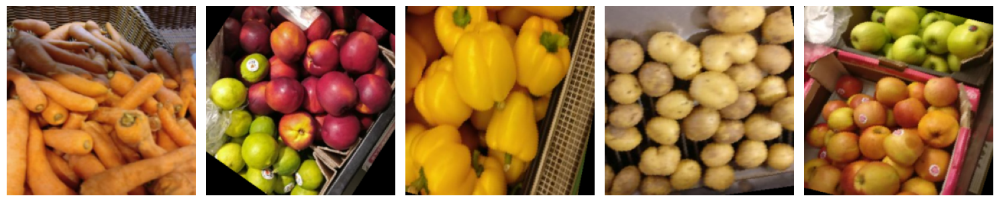

Epoch 30: lr 1e-05 - train loss 0.317 - train acc 0.912 - valid loss 1.221 - valid acc 0.655
Epoch 30: best acc 0.655
Epoch 33: lr 1e-05 - train loss 0.272 - train acc 0.932 - valid loss 1.216 - valid acc 0.659
Epoch 33: best acc 0.659
Epoch 36: lr 1e-05 - train loss 0.262 - train acc 0.934 - valid loss 1.258 - valid acc 0.642
Epoch 36: best acc 0.659
Epoch 39: lr 1e-05 - train loss 0.263 - train acc 0.936 - valid loss 1.244 - valid acc 0.649
Epoch 39: best acc 0.659
Best epoch 33, best acc 0.6587837837837838


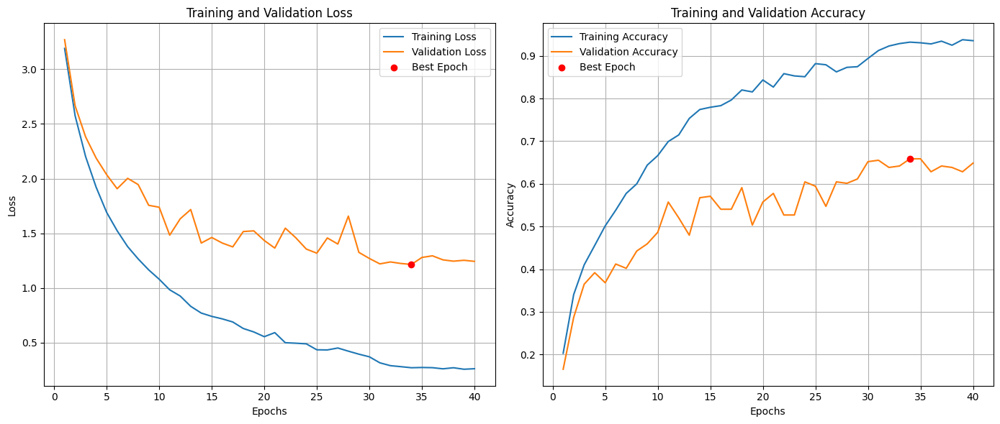

In [ ]:
min_delta = 0.1
fix_random(seed=42)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=30, gamma=0.1)
#provare con step 30

best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_pipeline(model,
                                                        train_loader,
                                                        num_epochs,
                                                        validation_loader,
                                                        verbose,
                                                        optimizer,
                                                        patience=patience,
                                                        min_delta=min_delta,
                                                        scheduler=scheduler)

plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)

In [32]:
model_name = "final_model"
model_export_path = "models"
save_net(model, model_export_path, model_name)
test_model(model, test_loader)

Model final_model saved correctly
Accuracy of the network on the test images: 68.93%


68.93360160965794

#### Evaluation of the forth model
The last netwrok is able to achive a **65.8%** accuracy on the **val set** and a **68.9%** accuracy on the **test set**.

Let's then visualize the error done by the network on the test set

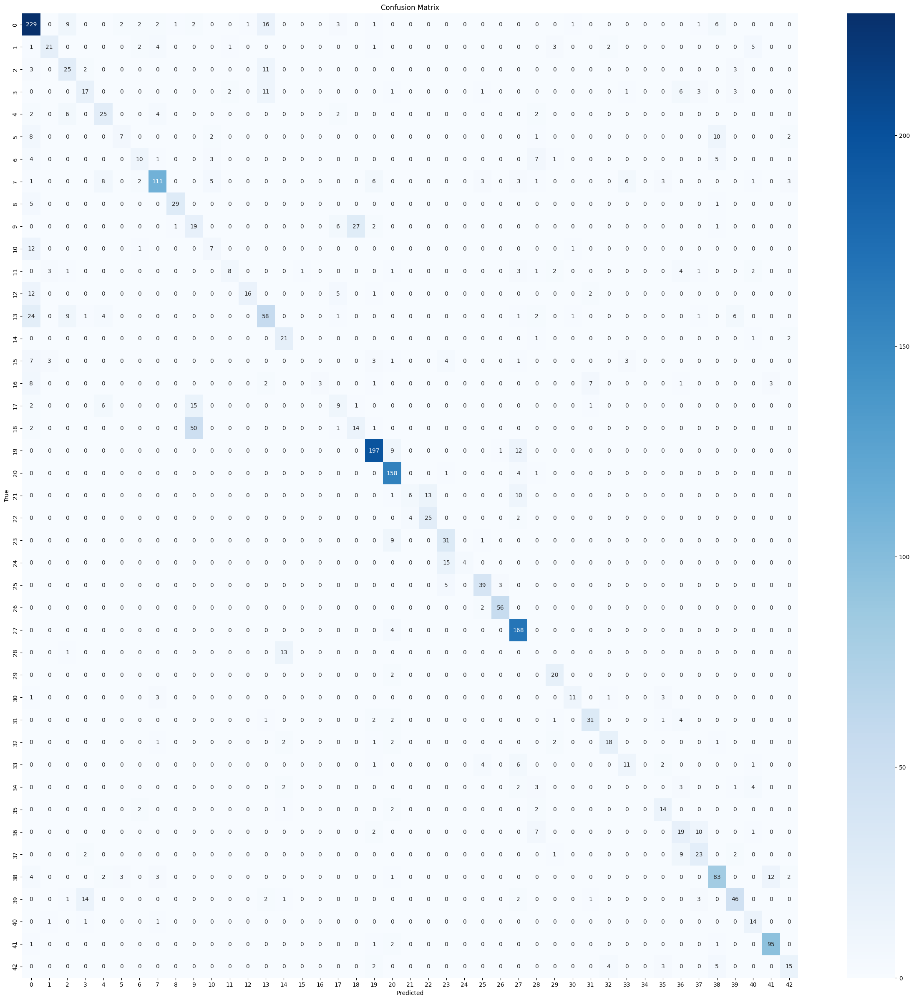

Top 10 misclassified classes:
Class Satsumas is most often misclassified as Class Orange with 50 errors.
Class Orange is most often misclassified as Class Satsumas with 27 errors.
Class Pear is most often misclassified as Class Apple with 24 errors.
Class Apple is most often misclassified as Class Pear with 16 errors.
Class Red-Grapefruit is most often misclassified as Class Orange with 15 errors.
Class Sour-Milk is most often misclassified as Class Sour-Cream with 15 errors.
Class Potato is most often misclassified as Class Kiwi with 14 errors.
Class Oatghurt is most often misclassified as Class Oat-Milk with 13 errors.
Class Asparagus is most often misclassified as Class Pineapple with 13 errors.
Class Papaya is most often misclassified as Class Apple with 12 errors.


[(18, (9, 50.0)),
 (9, (18, 27.0)),
 (13, (0, 24.0)),
 (0, (13, 16.0)),
 (17, (9, 15.0)),
 (24, (23, 15.0)),
 (39, (3, 14.0)),
 (21, (22, 13.0)),
 (28, (14, 13.0)),
 (10, (0, 12.0))]

In [33]:
confusion_matrix_result = confusion_matrix(model, test_loader, n_classes)
misclassified_classes = get_misclassified_classes(confusion_matrix_result.copy())
sorted_missclassified = visualize_top_misclassified_classes(misclassified_classes)

It is evident that certain classes are more frequently misclassified compared to others. This issue primarily occurs with classes that are very similar to each other, such as Satsumas and Oranges, Sour Milk and Sour Cream, and Pears and Apples (which can appear quite similar from certain perspectives).

But let's look at the occurrency of the classes in the dataset.

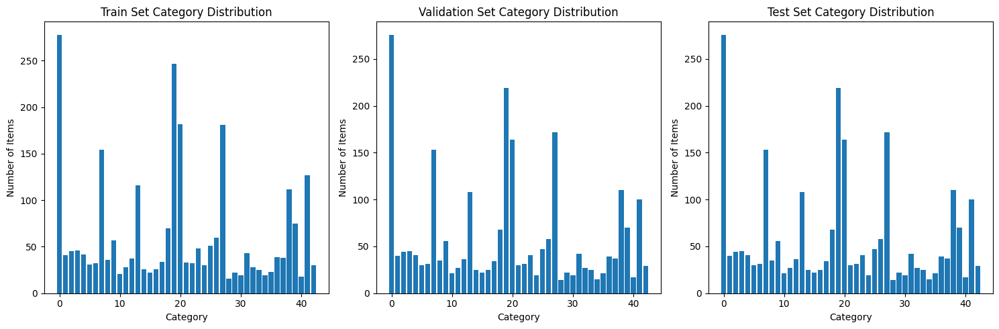

In [34]:
# Count the number of items for each category in the train and test set
train_counts = Counter(train_dataset.labels)
test_counts = Counter(test_dataset.labels)
val_counts = Counter(test_dataset.labels)

# Create a bar plot to visualize the distribution of categories
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.bar(train_counts.keys(), train_counts.values())
plt.title('Train Set Category Distribution')
plt.xlabel('Category')
plt.ylabel('Number of Items')

plt.subplot(1, 3, 2)
plt.bar(val_counts.keys(), val_counts.values())
plt.title('Validation Set Category Distribution')
plt.xlabel('Category')
plt.ylabel('Number of Items')

plt.subplot(1, 3, 3)
plt.bar(test_counts.keys(), test_counts.values())
plt.title('Test Set Category Distribution')
plt.xlabel('Category')
plt.ylabel('Number of Items')

plt.tight_layout()
plt.show()

From the graph it is immidiatly clear that some classes are way more frequent than other

In [35]:
max_id = max(train_counts, key=train_counts.get)
min_id = min(train_counts, key=train_counts.get)

id_to_name[max_id]
print(f"the most frequent in the training set is {id_to_name[max_id]} (id:{max_id}) with {train_counts[max_id]} occurrences")
print(f"the least frequent in the training set is {id_to_name[min_id]} (id:{min_id}) with {train_counts[min_id]} occurrences")

the most frequent in the training set is Apple (id:0) with 278 occurrences
the least frequent in the training set is Asparagus (id:28) with 16 occurrences


Let's visualize the error commited for each class compared to the occurrency

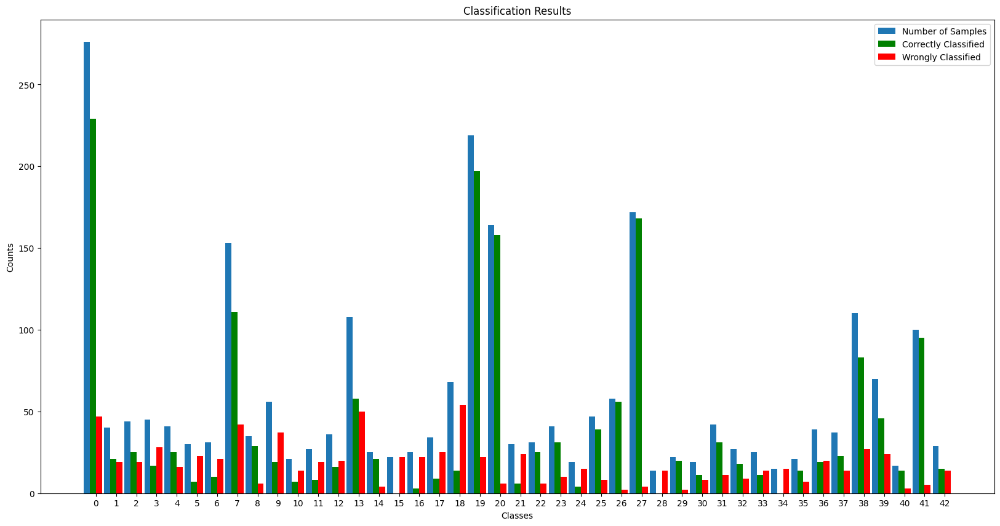

In [36]:
#confusion_matrix_result = confusion_matrix(model, test_loader, n_classes)
misclassified = {}

for true_class in range(confusion_matrix_result.shape[0]):
    # Ignore the diagonal (true positives)
    row = confusion_matrix_result[true_class, :]
    correctly_classified = row[true_class]
    row[true_class] = 0
    wrong_classified = sum(row)
    
    # Store the correctly and wrongly classified counts
    misclassified[true_class] = (correctly_classified, wrong_classified)
    
# Count the number of samples in each class in the test dataset
test_counts = Counter(test_dataset.labels)

# Prepare data for plotting
classes = list(test_counts.keys())
num_samples = [test_counts[cls] for cls in classes]
num_correctly_classified = [misclassified[cls][0] for cls in classes]
num_wrongly_classified = [misclassified[cls][1] for cls in classes]

# Plotting the histogram
x = range(len(classes))
width = 0.3



fig, ax = plt.subplots(figsize=(20, 10))

ax.bar(x, num_samples, width, label='Number of Samples')
ax.bar([p + width for p in x], num_correctly_classified, width, label='Correctly Classified', color='green')
ax.bar([p + width*2 for p in x], num_wrongly_classified, width, label='Wrongly Classified', color='red')

# Set labels and title
ax.set_xlabel('Classes')
ax.set_ylabel('Counts')
ax.set_title('Classification Results')
ax.set_xticks([p + 1.5 * width for p in x])
ax.set_xticklabels(classes)

plt.legend()
plt.show()

It seams like the data with less occurrency presents an higher miscclassification error than the one with more occurrency. In a try to solve this issue we are gonna try to perform a weighted training.

### Weighted Training

Through various plots, we observed that our dataset is unbalanced, with some classes significantly underrepresented compared to others. To address this issue and improve performance, we experimented with using weighted classes during training.

Weighted classes can be beneficial because they help the model pay more attention to underrepresented classes, reducing bias and improving overall accuracy. By assigning higher weights to less frequent classes, the model can learn to recognize these classes more effectively, leading to better generalization.

There are multiple methods to determine the weights for each class. We explored three approaches:

   * **Inverse Frequency**: Assigning weights inversely proportional to the class frequencies.
   * **Scikit-learn Function**: Utilizing the compute_class_weight function from the scikit-learn library to automatically calculate the weights.
   * **Manual Labeling**: Manually assigning weights based on domain knowledge and intuition.

Despite our efforts, none of these methods resulted in improved performance. The model’s accuracy and generalization did not show significant enhancement with the application of weighted classes.


In [76]:
from sklearn.utils.class_weight import compute_class_weight

y = train_dataset.labels
weights = compute_class_weight(class_weight="balanced", classes=np.unique(y), y=y)

DefNet(
  (stage1): ConvoStageBN(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage2): ConvoStageBN(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage3): ConvoStageBN(
    (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
    (MaxPool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (stage4): ConvoStageBN(
    (conv): Conv2d(128, 256, kernel_size=

  0%|          | 0/40 [00:00<?, ?it/s]

First 5 images of the epoch:


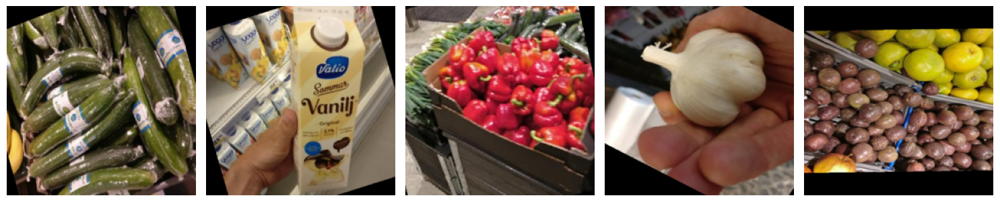

Epoch 0: lr 0.0001 - train loss 3.486 - train acc 0.099 - valid loss 3.585 - valid acc 0.044
Epoch 0: best acc 0.044
Epoch 3: lr 0.0001 - train loss 2.259 - train acc 0.288 - valid loss 2.553 - valid acc 0.243
Epoch 3: best acc 0.243
Epoch 6: lr 0.0001 - train loss 1.655 - train acc 0.443 - valid loss 2.305 - valid acc 0.294
Epoch 6: best acc 0.294
Epoch 9: lr 0.0001 - train loss 1.317 - train acc 0.539 - valid loss 2.006 - valid acc 0.389
Epoch 9: best acc 0.389
First 5 images of the epoch:


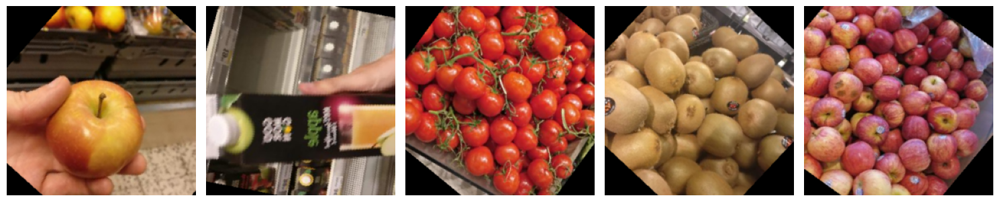

Epoch 12: lr 0.0001 - train loss 1.068 - train acc 0.627 - valid loss 2.069 - valid acc 0.392
Epoch 12: best acc 0.402
Epoch 15: lr 0.0001 - train loss 0.939 - train acc 0.661 - valid loss 1.785 - valid acc 0.432
Epoch 15: best acc 0.432
Epoch 18: lr 0.0001 - train loss 0.758 - train acc 0.728 - valid loss 1.758 - valid acc 0.453
Epoch 18: best acc 0.453
First 5 images of the epoch:


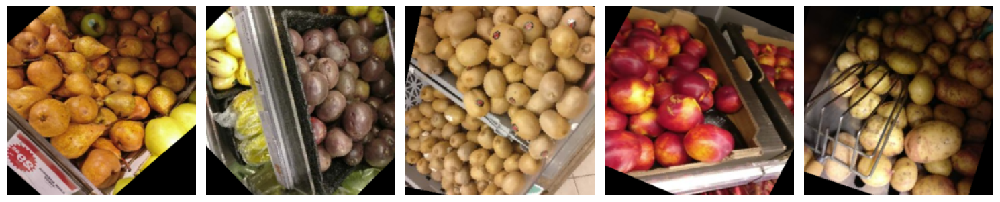

Epoch 21: lr 0.0001 - train loss 0.646 - train acc 0.764 - valid loss 1.951 - valid acc 0.416
Epoch 21: best acc 0.453
Epoch 24: lr 0.0001 - train loss 0.553 - train acc 0.795 - valid loss 1.747 - valid acc 0.436
Epoch 24: best acc 0.517
Epoch 27: lr 0.0001 - train loss 0.523 - train acc 0.807 - valid loss 1.750 - valid acc 0.510
Epoch 27: best acc 0.517
First 5 images of the epoch:


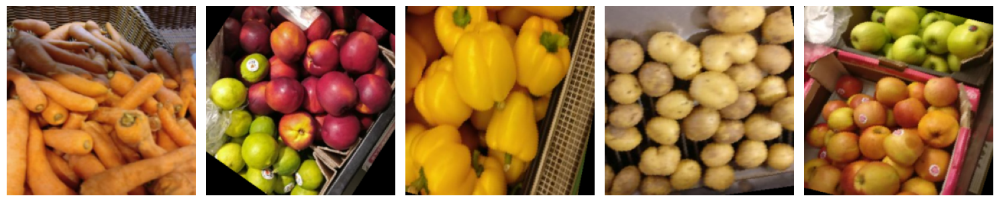

Epoch 30: lr 1e-05 - train loss 0.411 - train acc 0.848 - valid loss 1.619 - valid acc 0.503
Epoch 30: best acc 0.517
Epoch 33: lr 1e-05 - train loss 0.344 - train acc 0.877 - valid loss 1.545 - valid acc 0.547
Epoch 33: best acc 0.547
Epoch 36: lr 1e-05 - train loss 0.332 - train acc 0.883 - valid loss 1.567 - valid acc 0.534
Epoch 36: best acc 0.547
Epoch 39: lr 1e-05 - train loss 0.338 - train acc 0.874 - valid loss 1.578 - valid acc 0.537
Epoch 39: best acc 0.547
Best epoch 33, best acc 0.5472972972972973


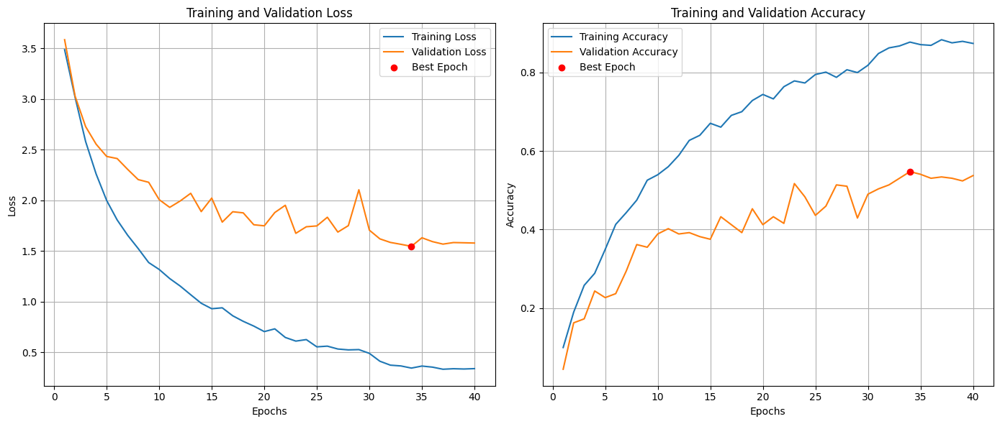

In [ ]:
batch_size = 64
num_epochs = 40
learning_rate = 1e-4
hidden_dim = 1024
verbose=True
dropout = 0.5
patience = 20


model = DefNet(
    hidden_dim,
    n_classes,
    dropout = dropout
)

print(model)

min_delta = 0.1
fix_random(seed=42)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=30, gamma=0.1)

best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_pipeline(model,
                                                        train_loader,
                                                        num_epochs,
                                                        validation_loader,
                                                        verbose,
                                                        optimizer,
                                                        patience=patience,
                                                        min_delta=min_delta,
                                                        scheduler=scheduler,
                                                        weight=weights
)

plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)

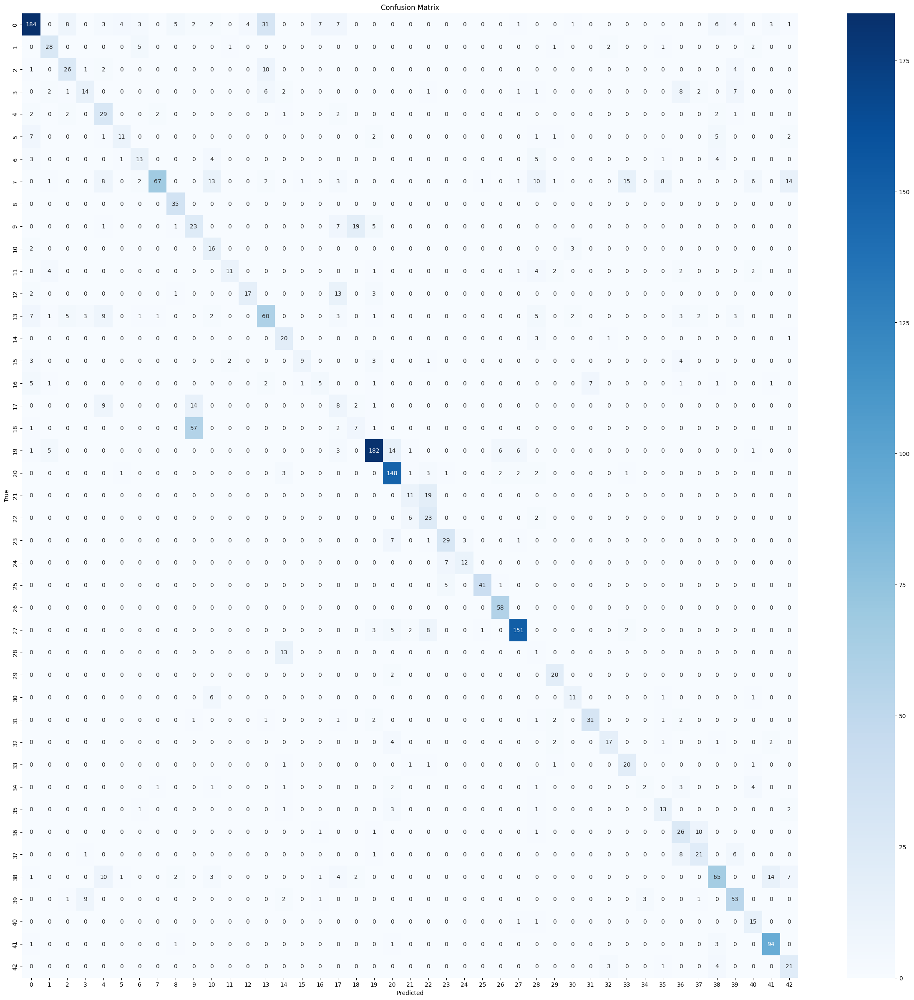

Top 10 misclassified classes:
Class Satsumas is most often misclassified as Class Orange with 57 errors.
Class Apple is most often misclassified as Class Pear with 31 errors.
Class Orange is most often misclassified as Class Satsumas with 19 errors.
Class Oatghurt is most often misclassified as Class Oat-Milk with 19 errors.
Class Melon is most often misclassified as Class Garlic with 15 errors.
Class Red-Grapefruit is most often misclassified as Class Orange with 14 errors.
Class Juice is most often misclassified as Class Milk with 14 errors.
Class Pepper is most often misclassified as Class Tomato with 14 errors.
Class Peach is most often misclassified as Class Red-Grapefruit with 13 errors.
Class Asparagus is most often misclassified as Class Pineapple with 13 errors.


In [78]:
confusion_matrix_result = confusion_matrix(model, test_loader, n_classes)
misclassified_classes = get_misclassified_classes(confusion_matrix_result.copy())
sorted_missclassified = visualize_top_misclassified_classes(misclassified_classes)

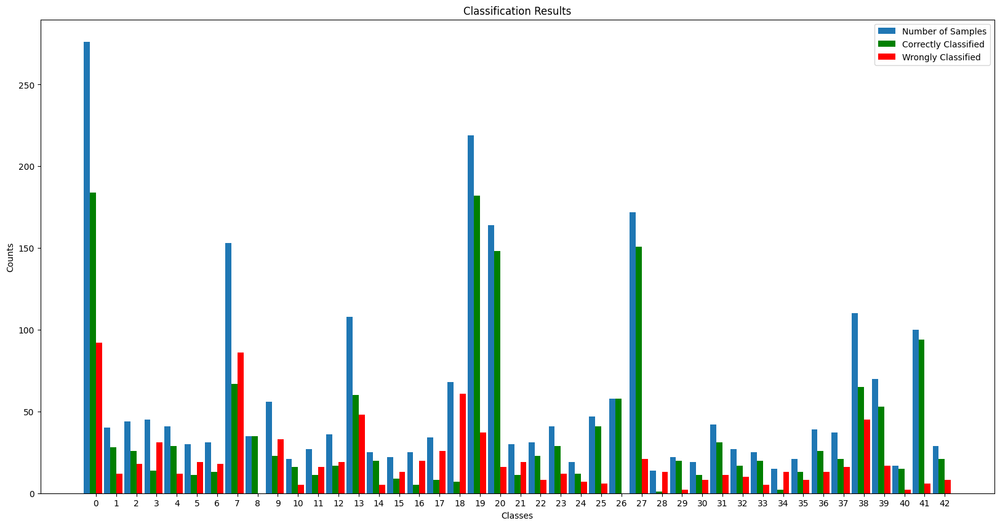

In [79]:
#confusion_matrix_result = confusion_matrix(model, test_loader, n_classes)
misclassified = {}

for true_class in range(confusion_matrix_result.shape[0]):
    # Ignore the diagonal (true positives)
    row = confusion_matrix_result[true_class, :]
    correctly_classified = row[true_class]
    row[true_class] = 0
    wrong_classified = sum(row)
    
    # Store the correctly and wrongly classified counts
    misclassified[true_class] = (correctly_classified, wrong_classified)
    
# Count the number of samples in each class in the test dataset
test_counts = Counter(test_dataset.labels)

# Prepare data for plotting
classes = list(test_counts.keys())
num_samples = [test_counts[cls] for cls in classes]
num_correctly_classified = [misclassified[cls][0] for cls in classes]
num_wrongly_classified = [misclassified[cls][1] for cls in classes]

# Plotting the histogram
x = range(len(classes))
width = 0.3

fig, ax = plt.subplots(figsize=(20, 10))

ax.bar(x, num_samples, width, label='Number of Samples')
ax.bar([p + width for p in x], num_correctly_classified, width, label='Correctly Classified', color='green')
ax.bar([p + width*2 for p in x], num_wrongly_classified, width, label='Wrongly Classified', color='red')

# Set labels and title
ax.set_xlabel('Classes')
ax.set_ylabel('Counts')
ax.set_title('Classification Results')
ax.set_xticks([p + 1.5 * width for p in x])
ax.set_xticklabels(classes)

plt.legend()
plt.show()

In [80]:
test_model(model, test_loader)

Accuracy of the network on the test images: 66.32%


66.31790744466801

As mentioned earlier, the performance did not improve. Despite giving more weight to errors affecting underrepresented classes, as shown in the graphs, these classes continue to be largely misclassified. (as class 11, 16, 28 and 34)


## Part 2: fine-tune an existing network

Your goal is to fine-tune a pretrained **ResNet-18** model on `GroceryStoreDataset`. Use the implementation provided by PyTorch, do not implement it yourselves! (i.e. exactly what you **could not** do in the first part of the assignment). Specifically, you must use the PyTorch ResNet-18 model pretrained on ImageNet-1K (V1). Divide your fine-tuning into two parts:

1. First, fine-tune the Resnet-18 with the same training hyperparameters you used for your best model in the first part of the assignment.
1. Then, tweak the training hyperparameters in order to increase the accuracy on the validation split of `GroceryStoreDataset`. Justify your choices by analyzing the training plots and/or citing sources that guided you in your decisions (papers, blog posts, YouTube videos, or whatever else you find enlightening). You should consider yourselves satisfied once you obtain a classification accuracy on the **validation** split **between 80 and 90%**.

### Part 2.1 
In this part we will train the ResNet arhitecture using our best network hyperparameters 

#### Data Loaders 
Since we are working on an already trained network an important step is to ensure that the data recive the same preprocessing that the one used for the initial training of the network. Using the same data preprocessing ensures the input data matches the original training format and scale. To create the correct transormation we consulted the [documentation](http://pytorch.org/vision/main/models/generated/torchvision.models.resnet18.html) that describe the process for the inference transforms.  


In [50]:
batch_size = 64
image_size = 224

train_transform = T.Compose([
    T.Resize(256, interpolation=InterpolationMode.BILINEAR),
    T.CenterCrop(224),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

basic_transform = T.Compose([
    T.ToTensor(),
    T.Resize((image_size, image_size)),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

#Divide the dataset into training and test sets
train_dataset = GroceryStoreDataset("train", transform=train_transform)
test_dataset = GroceryStoreDataset("test", transform=basic_transform)
validation_dataset = GroceryStoreDataset("val", transform=basic_transform)

#Define the loaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)

#### Import the pretrained model
As first step we initializes a pretrained ResNet-18 model using weights from the ImageNet-1K dataset and freezes its parameters to prevent updates during training. 
Subsequently, the fully connected layer is replaced to align with the desired number of prediction labels, making this layer trainable. 
Finally, the modified network architecture is displayed for verification.

In [51]:
#Import the pretrained model with the weights used for the ImageNet-1K (V1) dataset
resnet18 = models.resnet18(weights='IMAGENET1K_V1')

#freeze the model
for param in resnet18.parameters():
    param.requires_grad = False

#Substitute the Fully Connected Layer of the ResNet-18 to match the number of prediction labels we have. This operation will also unfreeze the FC layer.
in_features = resnet18.fc.in_features
resnet18.fc = nn.Linear(in_features, n_classes)

#Check the network
print(resnet18)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

#### Finetuning 1 - Training of only the last fully connected layer
To follow the instructions given in Laboratory 5, we will first perform finetuning by training only the last fully connected layer. This approach allows us to estimate the base performance of the network and evaluate the effectiveness of the pre-trained features extracted by the earlier layers.

During this operation, we will use the same hyperparameters that were used to train our best network. Since the training is split into two parts, the number of epochs is also divided so that their sum equals the total number of epochs required.

  0%|          | 0/20 [00:00<?, ?it/s]

First 5 images of the epoch:


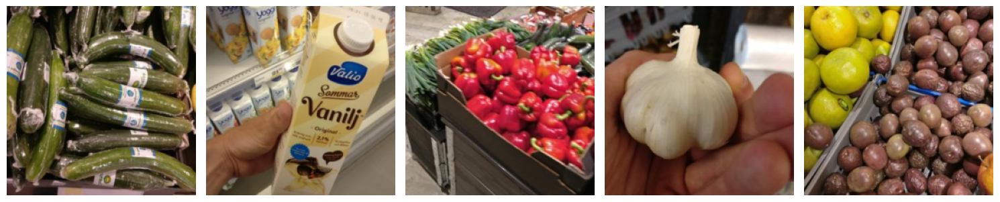

Epoch 0: lr 0.0001 - train loss 3.481 - train acc 0.083 - valid loss 3.367 - valid acc 0.155
Epoch 0: best acc 0.155
Epoch 3: lr 0.0001 - train loss 2.647 - train acc 0.366 - valid loss 2.780 - valid acc 0.304
Epoch 3: best acc 0.304
Epoch 6: lr 0.0001 - train loss 2.136 - train acc 0.498 - valid loss 2.368 - valid acc 0.426
Epoch 6: best acc 0.426
Epoch 9: lr 0.0001 - train loss 1.755 - train acc 0.614 - valid loss 2.075 - valid acc 0.493
Epoch 9: best acc 0.493
First 5 images of the epoch:


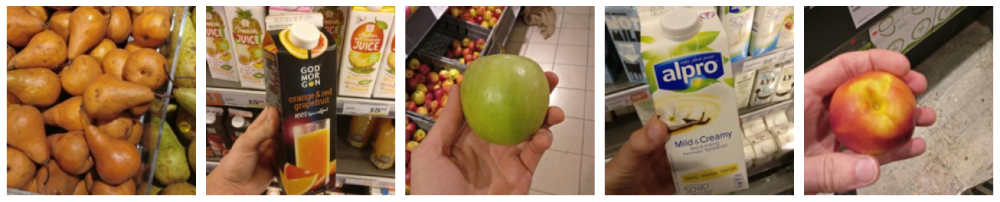

Epoch 12: lr 0.0001 - train loss 1.472 - train acc 0.698 - valid loss 1.857 - valid acc 0.544
Epoch 12: best acc 0.544
Epoch 15: lr 0.0001 - train loss 1.256 - train acc 0.753 - valid loss 1.682 - valid acc 0.571
Epoch 15: best acc 0.571
Epoch 18: lr 0.0001 - train loss 1.084 - train acc 0.802 - valid loss 1.554 - valid acc 0.608
Epoch 18: best acc 0.608
Best epoch 19, best acc 0.6182432432432432


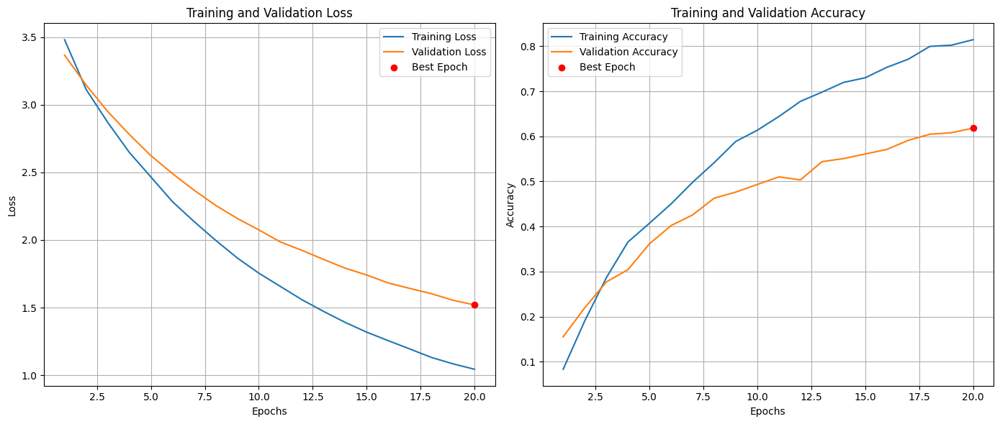

In [ ]:
num_epochs = 20
learning_rate = 1e-4
verbose=True
patience = 5

#Next, we will train the classifier of the model on our dataset.
optimizer = torch.optim.AdamW(resnet18.parameters(), lr=learning_rate)
fix_random(seed=42)
best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_pipeline(resnet18, 
                                                        train_loader, 
                                                        num_epochs, 
                                                        validation_loader, 
                                                        verbose,
                                                        optimizer,
                                                        patience = patience,
                                                        normalize_imgs=True)
# Plot the loss and accuracy graphs
plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)

In [53]:
model_name = "pt_2.1_finetune1"
model_export_path = 'models'
save_net(resnet18, model_export_path, model_name)
test_model(resnet18, test_loader)

Model pt_2.1_finetune1 saved correctly
Accuracy of the network on the test images: 64.51%


64.50704225352112

#### Finetuning 2 - Unfreeze the feature extractor weight 

The previus network achieves a **61.8%** accuracy on the validation set and a **64.5%** accuracy on the test set. While these results are promising, further improvements are necessary to enhance the network’s performance. To achieve this, the next step involves optimizing the hyperparameters and experimenting with different architectures to identify the most effective configuration for our specific task. 

In [54]:
best_val_acc_pt1, best_params_pt1, best_epoch_pt1, train_losses_pt1, val_losses_pt1, train_accs_pt1, val_accs_pt1 = best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs

  0%|          | 0/20 [00:00<?, ?it/s]

First 5 images of the epoch:


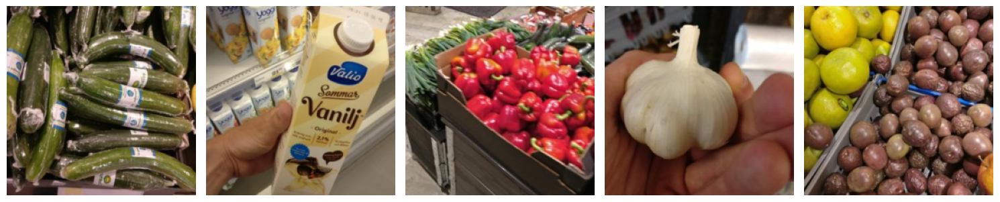

Epoch 0: lr 0.0001 - train loss 0.448 - train acc 0.924 - valid loss 0.599 - valid acc 0.858
Epoch 0: best acc 0.858
Epoch 3: lr 0.0001 - train loss 0.011 - train acc 1.000 - valid loss 0.446 - valid acc 0.868
Epoch 3: best acc 0.895
Epoch 6: lr 0.0001 - train loss 0.005 - train acc 1.000 - valid loss 0.426 - valid acc 0.885
Epoch 6: best acc 0.895
Early stopping at epoch 10
Best epoch 2, best acc 0.8952702702702703


In [ ]:
#Unfreeze the model
for param in resnet18.parameters():
    param.requires_grad = True


num_epochs = 20

#Next, we will train the classifier of the model on our dataset.
optimizer = torch.optim.AdamW(resnet18.parameters(), lr=learning_rate)

fix_random(seed=42)
best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_pipeline(resnet18, 
                                                       train_loader, 
                                                       num_epochs, 
                                                       validation_loader, 
                                                       verbose,
                                                       optimizer,
                                                       patience = patience,
                                                       normalize_imgs=True)

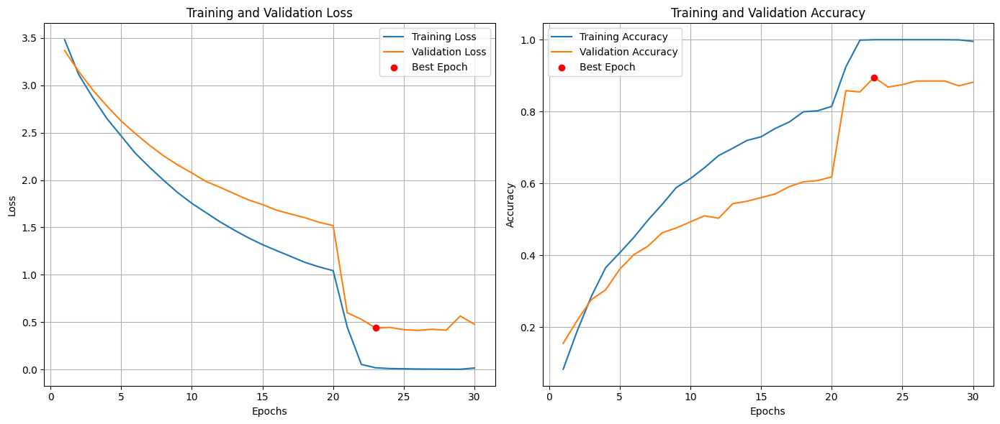

In [56]:
train_losses_combined = train_losses_pt1 + train_losses
val_losses_combined = val_losses_pt1 + val_losses
train_accs_combined = train_accs_pt1 + train_accs
val_accs_combined = val_accs_pt1 + val_accs

plot_training_stats(train_losses_combined, val_losses_combined, train_accs_combined, val_accs_combined, best_epoch+num_epochs)

In [57]:
model_name = "pt_2.1_finetune2"
model_export_path = 'models'
save_net(resnet18, model_export_path, model_name)
test_model(resnet18, test_loader)

Model pt_2.1_finetune2 saved correctly
Accuracy of the network on the test images: 85.55%


85.55331991951711

#### Evaluation of the finetuned ResNet18
The last netwrok is able to achive a **89.5%** accuracy on the **val set** and a **85.5%** accuracy on the **test set**.
The model fine-tuned with the hyperparameters of our best network surprisingly achieves good performance, which will be difficult to surpass in section 2.2.

### Part2.2
The performances achived by the previus network were already really good. But we tryied anyway to achive a slightly better score using some other training technique: 
- Data augmentation
- Change the number of epoch
- Usage of the learning rate schedule

### Data augmentation 
To avoid overfitting we added new transformation layers to the `train_transform`. This step of data augmentation should help the network to avoid overfitting by introducing variability in the training data. The transformations used are the same used to train our best model in the part 1. 
By applying these transformations, we aim to enhance the generalization capability of the network, ensuring it performs well not only on the training data but also on unseen data.

In [58]:
batch_size = 64
image_size = 224

train_transform = T.Compose([
    T.Resize(256, interpolation=InterpolationMode.BILINEAR),
    T.RandomHorizontalFlip(),
    T.RandomRotation(90),
    T.RandomResizedCrop(224, scale=(0.7, 1.0)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

basic_transform = T.Compose([
    T.ToTensor(),
    T.Resize((image_size, image_size)),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

#Divide the dataset into training and test sets
train_dataset = GroceryStoreDataset("train", transform=train_transform)
test_dataset = GroceryStoreDataset("test", transform=basic_transform)
validation_dataset = GroceryStoreDataset("val", transform=basic_transform)

#Define the loaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)


#### Finetuning 

In [59]:
#Import the pretrained model with the weights used for the ImageNet-1K (V1) dataset
resnet18 = models.resnet18(weights='IMAGENET1K_V1')

#freeze the model
for param in resnet18.parameters():
    param.requires_grad = False

#Next, we need to substitute the Fully Connected Layer of the ResNet-18 to match the number of prediction labels we have.
#This operation will also unfreeze the FC layer.
in_features = resnet18.fc.in_features
resnet18.fc = nn.Linear(in_features, n_classes)

  0%|          | 0/20 [00:00<?, ?it/s]

First 5 images of the epoch:


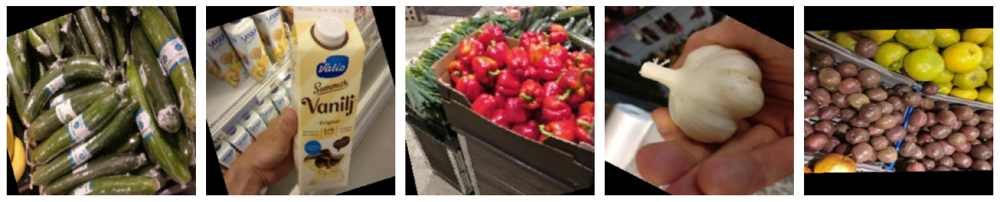

Epoch 0: lr 0.0001 - train loss 3.477 - train acc 0.112 - valid loss 3.390 - valid acc 0.111
Epoch 0: best acc 0.111
Epoch 3: lr 0.0001 - train loss 2.782 - train acc 0.262 - valid loss 2.877 - valid acc 0.287
Epoch 3: best acc 0.287
Epoch 6: lr 0.0001 - train loss 2.343 - train acc 0.395 - valid loss 2.507 - valid acc 0.345
Epoch 6: best acc 0.345
Epoch 9: lr 0.0001 - train loss 2.012 - train acc 0.510 - valid loss 2.240 - valid acc 0.395
Epoch 9: best acc 0.395
First 5 images of the epoch:


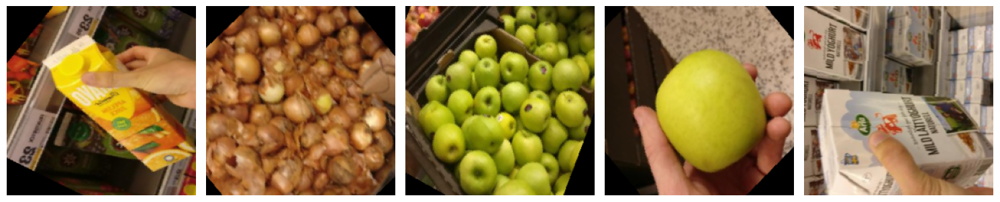

Epoch 12: lr 0.0001 - train loss 1.757 - train acc 0.598 - valid loss 2.026 - valid acc 0.432
Epoch 12: best acc 0.432
Epoch 15: lr 0.0001 - train loss 1.546 - train acc 0.662 - valid loss 1.859 - valid acc 0.476
Epoch 15: best acc 0.476
Epoch 18: lr 0.0001 - train loss 1.393 - train acc 0.698 - valid loss 1.723 - valid acc 0.514
Epoch 18: best acc 0.514
Best epoch 18, best acc 0.5135135135135135


In [60]:
num_epochs = 20
learning_rate = 1e-4
verbose=True
patience = 5

#Next, we will train the classifier of the model on our dataset.
optimizer = torch.optim.AdamW(resnet18.parameters(), lr=learning_rate)
fix_random(seed=42)
best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_pipeline(resnet18, 
                                                       train_loader, 
                                                       num_epochs, 
                                                       validation_loader, 
                                                       verbose,
                                                       optimizer,
                                                       patience = patience, 
                                                       normalize_imgs=True)
# Plot the loss and accuracy graphs
#plot_training_stats(train_losses, val_losses, train_accs, val_accs, best_epoch)


  0%|          | 0/20 [00:00<?, ?it/s]

First 5 images of the epoch:


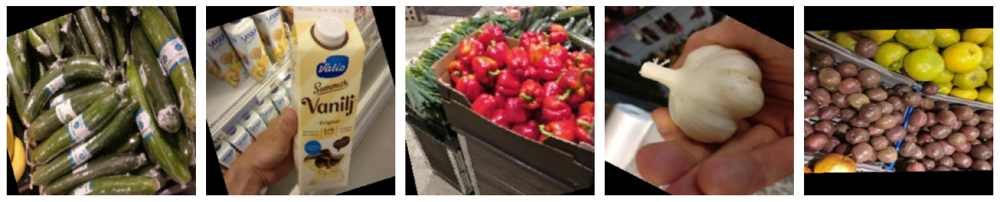

Epoch 0: lr 0.0001 - train loss 0.685 - train acc 0.842 - valid loss 0.769 - valid acc 0.774
Epoch 0: best acc 0.774
Epoch 3: lr 0.0001 - train loss 0.066 - train acc 0.994 - valid loss 0.402 - valid acc 0.902
Epoch 3: best acc 0.902
Epoch 12: lr 1e-05 - train loss 0.009 - train acc 1.000 - valid loss 0.343 - valid acc 0.902
Epoch 12: best acc 0.902
Epoch 15: lr 1e-05 - train loss 0.009 - train acc 1.000 - valid loss 0.346 - valid acc 0.909
Epoch 15: best acc 0.909
Early stopping at epoch 18
Best epoch 15, best acc 0.9087837837837838


In [61]:
best_val_acc_pt1, best_params_pt1, best_epoch_pt1, train_losses_pt1, val_losses_pt1, train_accs_pt1, val_accs_pt1 = best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs

#freeze the model
for param in resnet18.parameters():
    param.requires_grad = True

#Next, we will train the classifier of the model on our dataset.
optimizer = torch.optim.AdamW(resnet18.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=10, gamma=0.1)
fix_random(seed=42)
best_val_acc, best_params, best_epoch, train_losses, val_losses, train_accs, val_accs = train_pipeline(resnet18, 
                                                       train_loader, 
                                                       num_epochs, 
                                                       validation_loader, 
                                                       verbose,
                                                       optimizer,
                                                       patience = patience,
                                                       scheduler=scheduler, 
                                                       normalize_imgs=True)

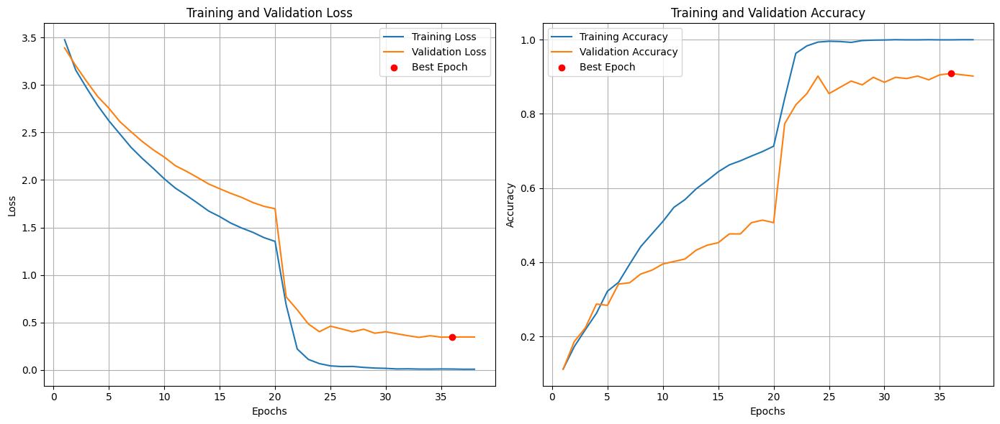

In [62]:
train_losses_combined = train_losses_pt1 + train_losses
val_losses_combined = val_losses_pt1 + val_losses
train_accs_combined = train_accs_pt1 + train_accs
val_accs_combined = val_accs_pt1 + val_accs

plot_training_stats(train_losses_combined, val_losses_combined, train_accs_combined, val_accs_combined, best_epoch+num_epochs)

In [63]:
model_name = "pt_2.2_finetuned"
model_export_path = 'models'
save_net(resnet18, model_export_path, model_name)
test_model(resnet18, test_loader)

Model pt_2.2_finetuned saved correctly
Accuracy of the network on the test images: 88.49%


88.49094567404427

#### Evaluation of the finetuned ResNet18
The last netwrok is able to achive a **90.8%** accuracy on the **val set** and a **88.5%** accuracy on the **test set**. \
Thanks to the new techniques employed, we were able to extract a few additional percentage points of accuracy from the model. Although the improvement is modest, it underscores the effectiveness of our refined approach.